# Unpaired img2img translation experiments

# TODO:
- Understand when and how should the scheduler clip samples
- Add a "slightly noised start" vs "inverted start" experiment

# Methods:

- **inversion** consists in finding the Gaussian sample that *would* generate the given image:
    - mathematically exact up to numerical precision and discretization errors (the denoiser performance *should not come into play* here)
    - allows to start the generation anywhere on that "natural" (...) diffusion path $\rightarrow$ *condtionning!*
    - to be compared with simply adding Gaussian noise to the image following the parametrized noising process (see *slightly noised start*)

The equation of the generative pass for DDIM is:
$$
x_{t-1}-x_t=\sqrt{\bar{\alpha}_{t-1}}\left[\left(\sqrt{1 / \bar{\alpha}_t}-\sqrt{1 / \bar{\alpha}_{t-1}}\right) x_t+\left(\sqrt{1 / \bar{\alpha}_{t-1}-1}-\sqrt{1 / \bar{\alpha}_t-1}\right) \epsilon_\theta\left(x_t\right)\right]
$$
With time reversed:
$$
x_{t+1}-x_t=\sqrt{\bar{\alpha}_{t+1}}\left[\left(\sqrt{1 / \bar{\alpha}_t}-\sqrt{1 / \bar{\alpha}_{t+1}}\right) x_t+\left(\sqrt{1 / \bar{\alpha}_{t+1}-1}-\sqrt{1 / \bar{\alpha}_t-1}\right) \epsilon_\theta\left(x_t\right)\right]
$$

---

- **custom guidance** consists in modifying the diffusion path by adding a guidance term to the being-denoised sample:
    - can be any *differentiable* guidance, like a (differentiable...) $L_p$ norm
    - the guidance term can be computed in the latent space or after decoding, in the image space 

---

- **initial "natural" denoising** consists in starting the denoising process without any kind of class translation or guidance, and switching to guided or class-transferred denoising at some point in the denoising path
    - allows keeping high-level features of the image
    - does not necessitate more computation than a usual denoising
---

- **slightly noised start** consists in starting the denoising process from a slightly noised initial image but using the *usual* "forward" noising process (*not* the inversion scheme)
    - it has the advantage of being performed in $\mathcal{O}(1)$
    - allows keeping high-level features of the image

---

- **classifier-free guidance** consists in using the conditional model itself as a guidance term, without any classifier or external model.
    - allows to control the strength of the guidance without interpolating the class embeddings

The equation from [the Imagen paper](https://arxiv.org/pdf/2205.11487.pdf) is:
$$
    \tilde{\epsilon} = \omega \epsilon_\text{cond} + (1-\omega) \epsilon_\text{uncond}
$$
Note that it is slightly different from the one proposed by [the original paper](https://arxiv.org/pdf/2207.12598.pdf) which uses the unconditional model as base.

# Device

In [1]:
import os

os.environ["CUDA_VISIBLE_DEVICES"] = "2"
# must apparently be placed before importing torch?
device = "cuda"

# Imports

In [2]:
import gc
import random
from argparse import Namespace
from datetime import datetime
from math import ceil
from pathlib import Path
from typing import Literal
from warnings import warn

import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import torch
from diffusers import (
    AutoencoderKL,
    DDIMInverseScheduler,
    DDIMScheduler,
    UNet2DConditionModel,
)
from diffusers.image_processor import VaeImageProcessor
from IPython.core.display import HTML
from PIL import Image
from torchvision import transforms
from torchvision.datasets import ImageFolder
from tqdm.auto import tqdm, trange

In [3]:
plt.style.use("bmh")

In [4]:
%load_ext autoreload
%autoreload 3

In [5]:
from src.cond_unet_2d import CustomCondUNet2DModel
from src.custom_embedding import CustomEmbedding
from src.custom_pipeline_stable_diffusion_img2img import (
    CustomStableDiffusionImg2ImgPipeline,
)
from src.pipeline_conditional_ddim import ConditionalDDIMPipeline
from src.utils_Img2Img import (
    check_Gaussianity,
    hack_class_embedding,
    print_grid,
    tensor_to_PIL,
)

# Common params

In [6]:
args = Namespace(resolution=128)

In [7]:
# args.batch_size = 64   # 12GB
# args.batch_size = 128  # 24GB
# args.batch_size = 192  # 32GB
args.batch_size = 256  # 44GB
# args.batch_size = 512    # 80GB

# Load pretrained pipelines

## DDIM

In [8]:
DDIM_pipeline_path = Path("experiments", "new_configs_test", "full_pipeline_save")

In [9]:
assert DDIM_pipeline_path.exists()
DDIM_pipeline = ConditionalDDIMPipeline.from_pretrained(DDIM_pipeline_path)
DDIM_denoiser = DDIM_pipeline.unet.to(device).eval()
DDIM_noise_scheduler = DDIM_pipeline.scheduler

## Stable Diffusion

In [10]:
SD_pipeline_path = Path("experiments", "SD_100_perc", "full_pipeline_save")

In [11]:
assert SD_pipeline_path.exists()
SD_pipeline = CustomStableDiffusionImg2ImgPipeline.from_pretrained(
    SD_pipeline_path, local_files_only=True
)
SD_denoiser: UNet2DConditionModel = (
    SD_pipeline.unet.to(device).eval().requires_grad_(False)
)
SD_noise_scheduler: DDIMScheduler = SD_pipeline.scheduler
SD_autoencoder: AutoencoderKL = SD_pipeline.vae.to(device).eval().requires_grad_(False)
SD_class_encoder: CustomEmbedding = (
    SD_pipeline.class_embedding.to(device).eval().requires_grad_(False)
)


The vae has an auxiliary processor:

In [12]:
# code from the original pipeline
vae_scale_factor = 2 ** (len(SD_autoencoder.config.block_out_channels) - 1)

image_processor = VaeImageProcessor(vae_scale_factor=vae_scale_factor)

## Pipelines check

Stable Diffusion

  0%|          | 0/50 [00:00<?, ?it/s]

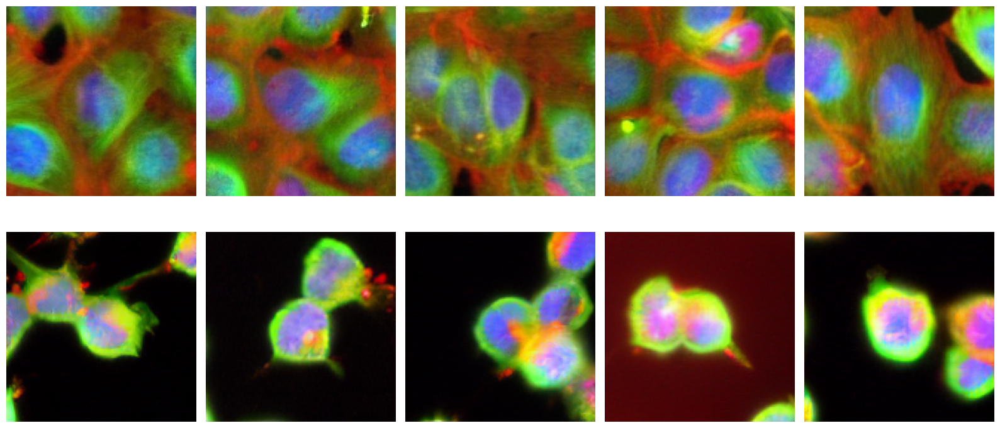

In [13]:
print_grid(
    SD_pipeline(
        latent_shape=(10, 4, 16, 16),
        class_labels=torch.tensor([0] * 5 + [1] * 5, device=device),
        strength=1,
    )
)

DDIM

  0%|          | 0/50 [00:00<?, ?it/s]

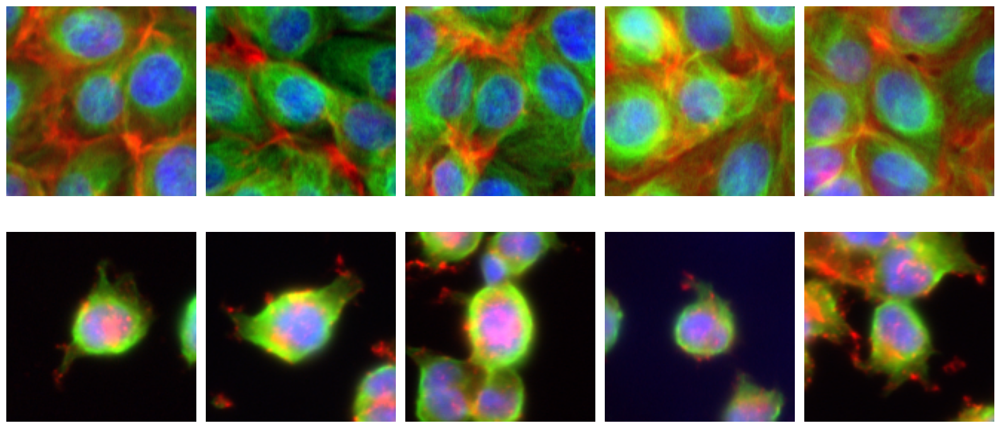

In [14]:
print_grid(
    DDIM_pipeline(
        class_labels=torch.tensor([0] * 5 + [1] * 5, device=device),
        class_emb=None,
        w=None,
        batch_size=10,
    ).images
)

# Load dataset

In [15]:
augmentations = transforms.Compose(
    [
        transforms.Resize(
            args.resolution, interpolation=transforms.InterpolationMode.BILINEAR
        ),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5]),  # map to [-1, 1] for SiLU
    ]
)

In [16]:
dataset_path = Path(
    "/" "projects",
    "deepdevpath",
    "Thomas",
    "data",
    "BBBC021_comp_conc_nice_phen_high_conc_balanced",
    "train",
)

In [17]:
dataset = ImageFolder(
    root=dataset_path.as_posix(),
    transform=lambda x: augmentations(x.convert("RGB")),
    target_transform=lambda y: torch.tensor(y).long(),
)

classes_seen_during_training = dataset.classes
class_to_index = dataset.class_to_idx

In [18]:
dataset

Dataset ImageFolder
    Number of datapoints: 26960
    Root location: /projects/deepdevpath/Thomas/data/BBBC021_comp_conc_nice_phen_high_conc_balanced/train
    StandardTransform
Transform: <function <lambda> at 0x7fe894571510>
Target transform: <function <lambda> at 0x7fe8946456c0>

# Randomly load samples from specified classes

In [19]:
selected_classes = ["DMSO", "latrunculin_B_high_conc"]
assert all(sel_cl in classes_seen_during_training for sel_cl in selected_classes)

# all samples across all classes must fit into memory
nb_samples_per_class = 5

In [20]:
sel_samples: dict[str, dict] = dict.fromkeys(selected_classes)
for sel_cl in selected_classes:
    sel_samples[sel_cl] = {
        "sample": torch.zeros(
            nb_samples_per_class, 3, args.resolution, args.resolution
        ).to(device),
        "sample_to_show": [None] * nb_samples_per_class,
    }

Samples from DMSO (index 0):


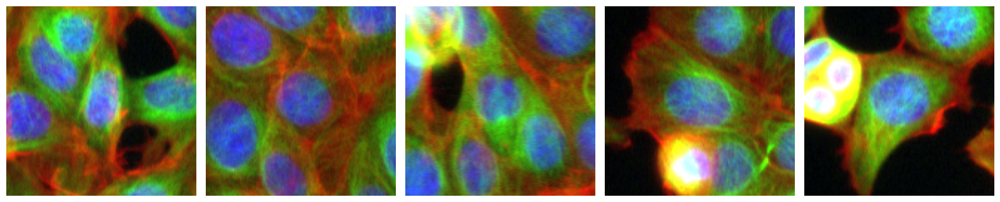

Samples from latrunculin_B_high_conc (index 1):


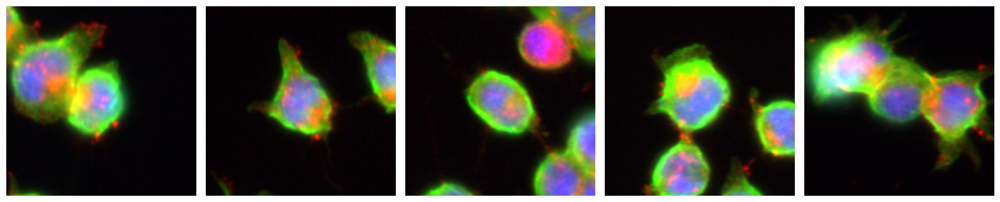

In [21]:
for sel_cl in selected_classes:
    cl_idx = torch.tensor(class_to_index[sel_cl]).long().to(device)
    sel_samples[sel_cl]["class_idx"] = cl_idx
    folder_path = Path(dataset_path, sel_cl)
    list_sample_names = random.sample(os.listdir(folder_path), nb_samples_per_class)
    for idx_sample, sample_name in enumerate(list_sample_names):
        sample_path = Path(folder_path, sample_name)
        sample_to_show = Image.open(sample_path).convert("RGB")
        sample = augmentations(Image.open(sample_path).convert("RGB")).to(device)
        sample.requires_grad_(False)
        sel_samples[sel_cl]["sample"][idx_sample] = sample.clone()
        sel_samples[sel_cl]["sample_to_show"][idx_sample] = sample_to_show
    print(f"Samples from {sel_cl} (index {class_to_index[sel_cl]}):")
    print_grid(sel_samples[sel_cl]["sample_to_show"])

Check that the embed preprocessor performs the exact same operations that the handcrafted ones here (for Stable Diffusion):

In [22]:
for sel_cl in selected_classes:
    sample_to_show = sel_samples[sel_cl]["sample_to_show"]
    sample = sel_samples[sel_cl]["sample"]
    assert torch.all(image_processor.preprocess(sample_to_show).to(device) == sample)

# Inversion

From [Diffusion Models Beat GANs on Image Synthesis](https://arxiv.org/pdf/2105.05233.pdf#appendix.F.)

In order transfer an image to some domain, we need to find the latent that *would* map to that sample.

![Capture d’écran du 2023-08-25 19-22-58.png](<attachment:Capture d’écran du 2023-08-25 19-22-58.png>)

The authors use 250 "reverse" steps (that is, to noise the image? *"reverse"* normally means from Gaussian to data), and only "reverse" the first 249 *(reverse?)* steps.  
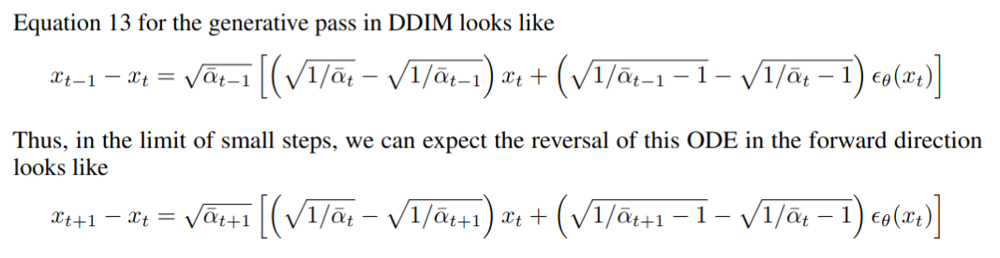

## Get inversed Gaussians

### Encode the images for Stable Diffusion

================================================ DMSO (index 0) ================================================
Original samples:


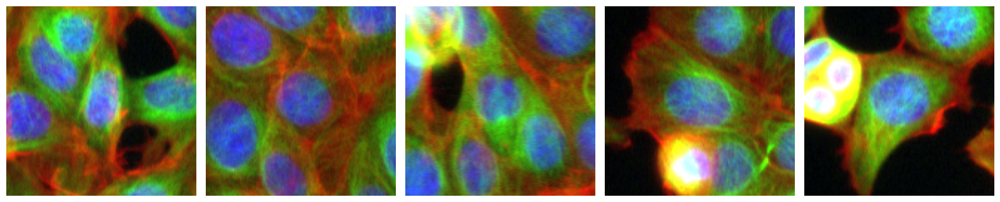

Latents (showing the mean over the 4 channels):


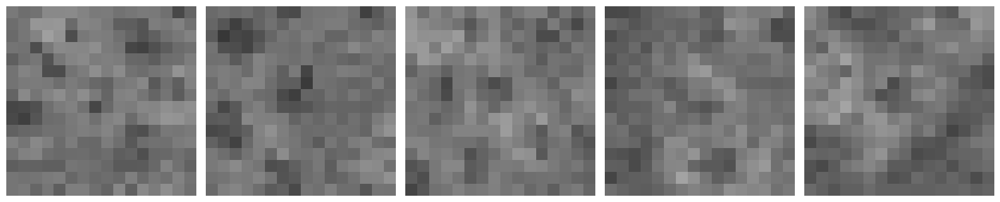

Latents (per channels):


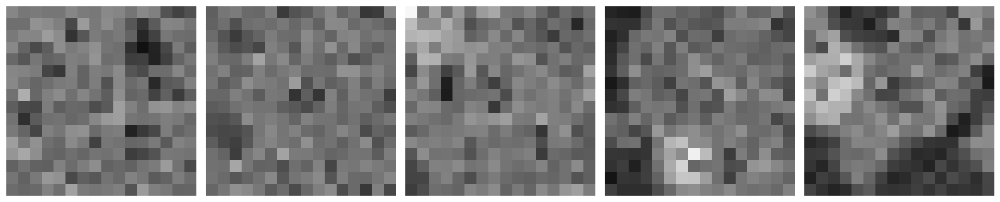

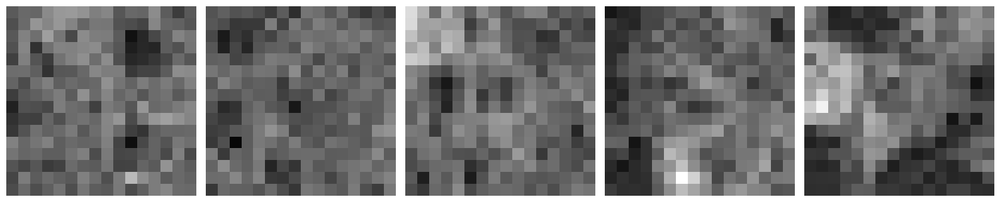

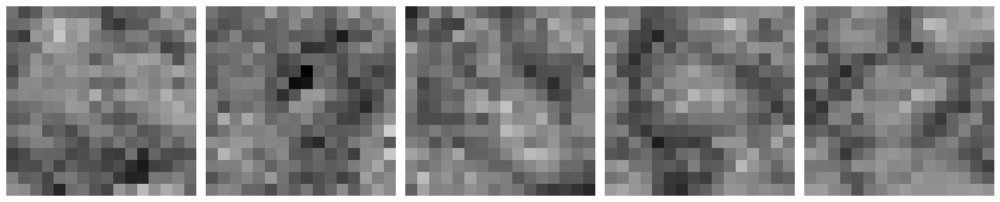

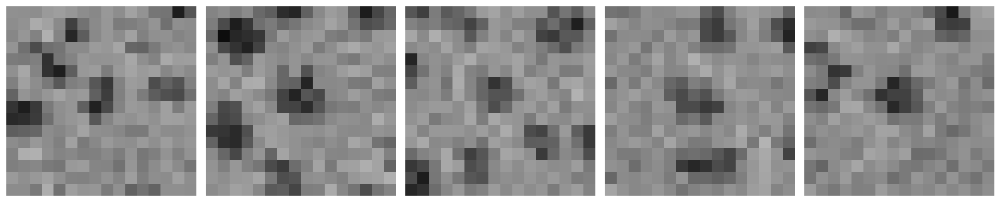

================================================ latrunculin_B_high_conc (index 1) ================================================
Original samples:


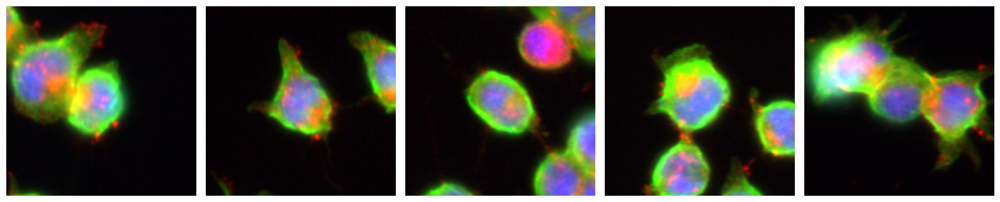

Latents (showing the mean over the 4 channels):


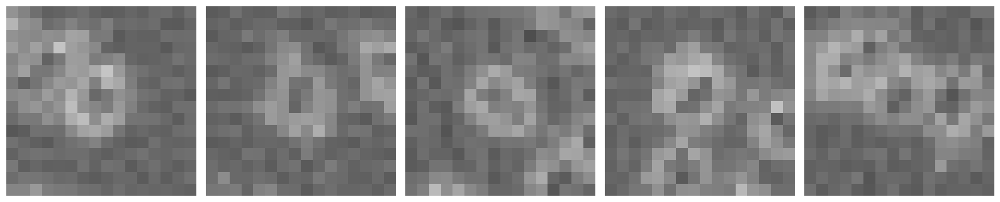

Latents (per channels):


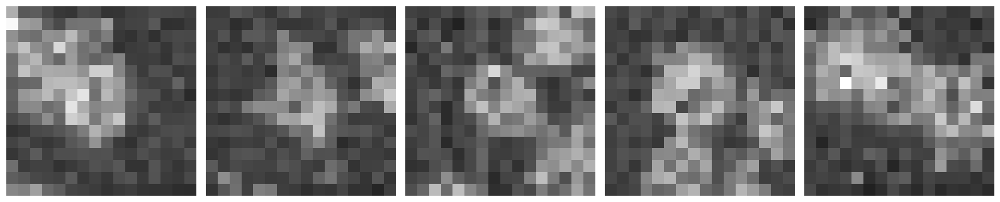

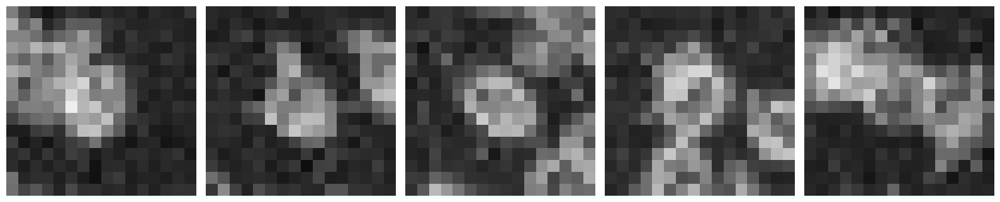

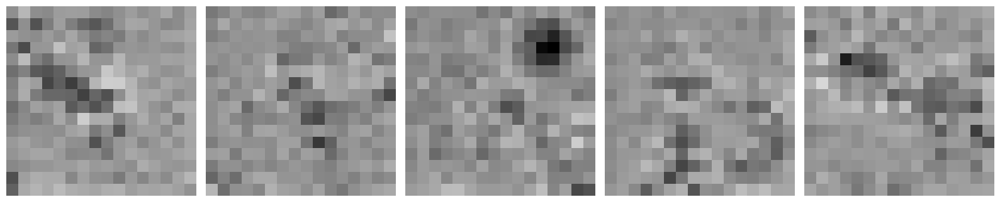

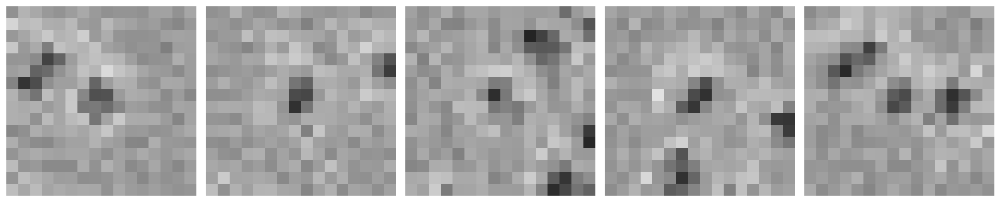

In [23]:
with torch.no_grad():
    for sel_cl in selected_classes:
        # encode
        latent = SD_autoencoder.encode(
            sel_samples[sel_cl]["sample"]
        ).latent_dist.sample()
        # scale
        latent *= SD_autoencoder.config.scaling_factor
        # save
        sel_samples[sel_cl]["latent"] = latent
        # save images (mean along 4 channels and then all separately)
        sel_samples[sel_cl]["latent_to_show_mean"] = tensor_to_PIL(
            sel_samples[sel_cl]["latent"]
        )
        for c in range(4):
            sel_samples[sel_cl][f"latent_to_show_{c}"] = tensor_to_PIL(
                sel_samples[sel_cl]["latent"], channel=c
            )
        print(
            f"================================================ {sel_cl} (index {class_to_index[sel_cl]}) ================================================"
        )
        print("Original samples:")
        print_grid(sel_samples[sel_cl]["sample_to_show"])
        print("Latents (showing the mean over the 4 channels):")
        print_grid(sel_samples[sel_cl]["latent_to_show_mean"])
        print("Latents (per channels):")
        for c in range(4):
            print_grid(sel_samples[sel_cl][f"latent_to_show_{c}"])


Test: decode these latents

================================================ DMSO (index 0) ================================================
Original samples:


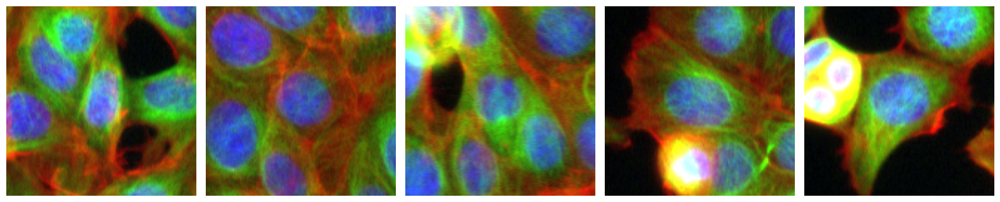

Reconstructed samples (directly from latents):


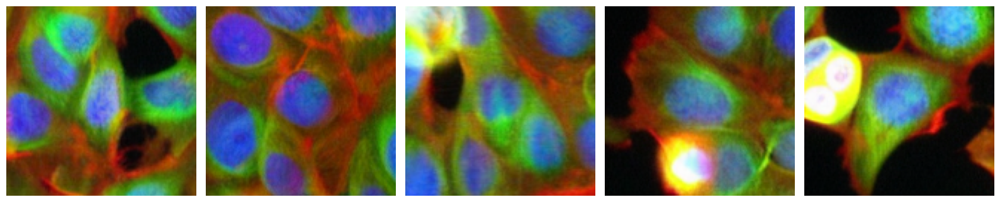

================================================ latrunculin_B_high_conc (index 1) ================================================
Original samples:


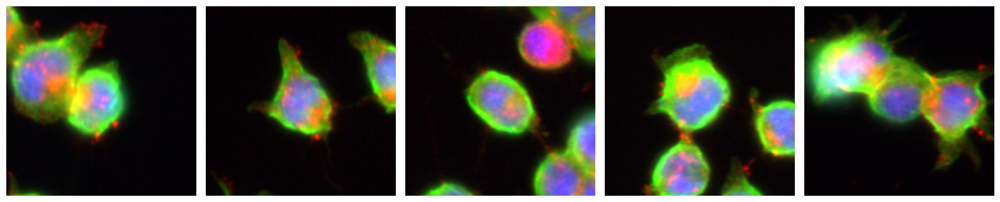

Reconstructed samples (directly from latents):


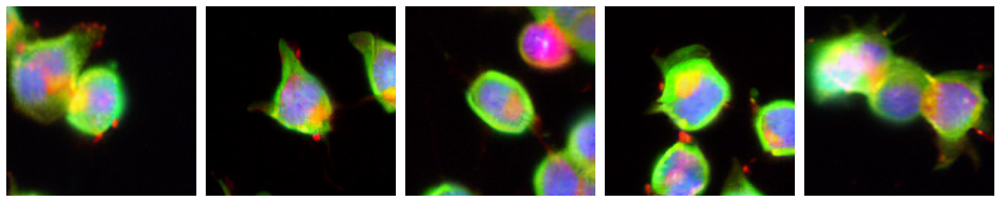

In [24]:
with torch.no_grad():
    # get the latents
    latent = torch.cat([sel_samples[sel_cl]["latent"] for sel_cl in selected_classes])
    test_reco = latent.clone().detach()

    # decode the latents into the reconstructed image
    test_reco = SD_autoencoder.decode(
        test_reco / SD_autoencoder.config.scaling_factor, return_dict=False
    )[0]

    # postprocess the image
    do_denormalize = [True] * test_reco.shape[0]
    test_reco = image_processor.postprocess(
        test_reco, output_type="pil", do_denormalize=do_denormalize
    )

    # save
    test_reco = [
        test_reco[i * nb_samples_per_class : (i + 1) * nb_samples_per_class]
        for i in range(len(selected_classes))
    ]
    for cl_idx, sel_cl in enumerate(selected_classes):
        print(
            f"================================================ {sel_cl} (index {class_to_index[sel_cl]}) ================================================"
        )
        print("Original samples:")
        print_grid(sel_samples[sel_cl]["sample_to_show"])
        print("Reconstructed samples (directly from latents):")
        print_grid(test_reco[cl_idx])

The vae performs quite well, although it suppresses the high frequencies.

### Obtain inverted Gaussians for Stable Diffusion

In [25]:
print(f"Number of training steps: {SD_noise_scheduler.config.num_train_timesteps}")


Number of training steps: 1000


In [26]:
# higher values give much better results (but take longer)
nb_noising_iter = 100

In [27]:
# should be in the range [1; scheduler.timesteps.max() + 1] (as scheduler.timesteps starts at zero)
assert nb_noising_iter <= SD_noise_scheduler.timesteps.max().item() + 1

SD_noise_scheduler.set_timesteps(nb_noising_iter)

# essentially, the inversion should follow the exact same discetization
# as the "forward" pass
SD_inv_scheduler: DDIMInverseScheduler = DDIMInverseScheduler.from_config(
    SD_noise_scheduler.config,
)
SD_inv_scheduler.set_timesteps(nb_noising_iter)

The config attributes {'skip_prk_steps': True} were passed to DDIMInverseScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


In [28]:
assert (reversed(SD_inv_scheduler.timesteps) == SD_noise_scheduler.timesteps).all()


In [29]:
SD_noise_scheduler

DDIMScheduler {
  "_class_name": "DDIMScheduler",
  "_diffusers_version": "0.18.2",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "clip_sample_range": 1.0,
  "dynamic_thresholding_ratio": 0.995,
  "num_train_timesteps": 1000,
  "prediction_type": "v_prediction",
  "rescale_betas_zero_snr": false,
  "sample_max_value": 1.0,
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "thresholding": false,
  "timestep_spacing": "leading",
  "trained_betas": null
}

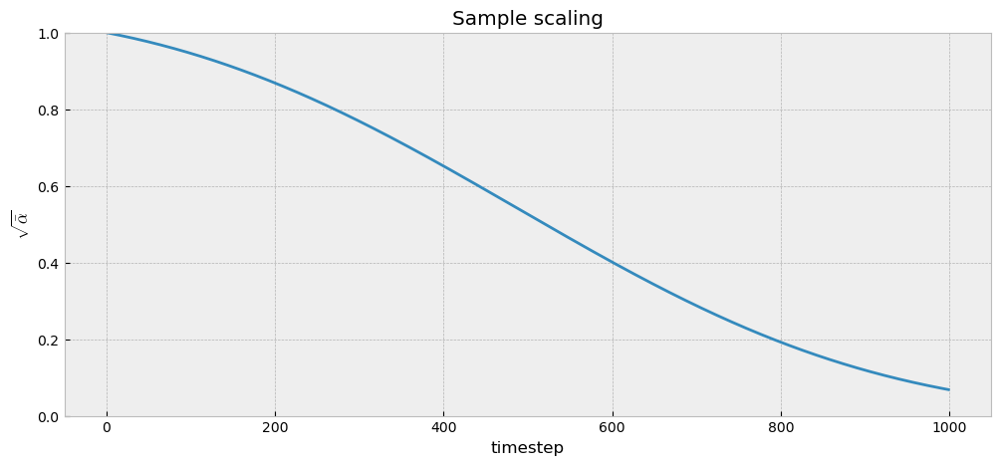

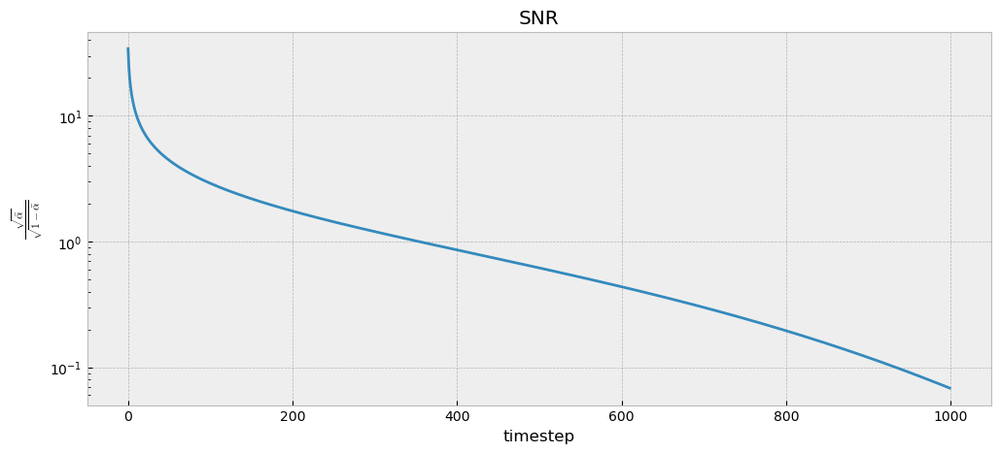

In [30]:
plt.figure(figsize=(12, 5))
plt.plot(np.sqrt(SD_noise_scheduler.alphas_cumprod))
plt.xlabel("timestep")
plt.ylabel(r"$\sqrt{\bar{\alpha}}$")
plt.ylim(0, 1)
plt.title("Sample scaling")
plt.show()

plt.figure(figsize=(12, 5))
plt.plot(
    np.sqrt(SD_noise_scheduler.alphas_cumprod)
    / np.sqrt(1 - SD_noise_scheduler.alphas_cumprod)
)
plt.xlabel("timestep")
plt.ylabel(r"$\frac{\sqrt{\bar{\alpha}}}{\sqrt{1 - \bar{\alpha}}}$")
plt.yscale("log")
plt.title("SNR")
plt.show()


In [31]:
with torch.no_grad():
    # get the latent representation of the sample
    latent = torch.cat([sel_samples[sel_cl]["latent"] for sel_cl in selected_classes])
    gauss = latent.clone().detach()

    # get the embedding for each class
    cl_idxes = [sel_samples[sel_cl]["class_idx"] for sel_cl in selected_classes]
    cl_embed = torch.cat(
        [
            SD_class_encoder(cl_idx).repeat(nb_samples_per_class, 1)
            for cl_idx in cl_idxes
        ]
    )

    cl_embed = hack_class_embedding(cl_embed)

    # invert the diffeq
    for t in tqdm(
        SD_inv_scheduler.timesteps,
        desc="Inverting latents to Gaussian space...",
        leave=False,
    ):
        model_output = SD_denoiser(gauss, t, encoder_hidden_states=cl_embed).sample

        gauss = SD_inv_scheduler.step(
            model_output,
            t,
            gauss,
        ).prev_sample

    # save
    gauss = torch.split(gauss, nb_samples_per_class)
    for cl_idx, sel_cl in enumerate(selected_classes):
        sel_samples[sel_cl]["SD_Gaussian"] = gauss[cl_idx]
        sel_samples[sel_cl]["SD_Gaussian_to_show_mean"] = tensor_to_PIL(gauss[cl_idx])
        for c in range(4):
            sel_samples[sel_cl][f"SD_Gaussian_to_show_{c}"] = tensor_to_PIL(
                gauss[cl_idx], channel=c
            )

Inverting latents to Gaussian space...:   0%|          | 0/100 [00:00<?, ?it/s]


################ Inverted Gaussians of latents of DMSO samples (mean over 4 channels):


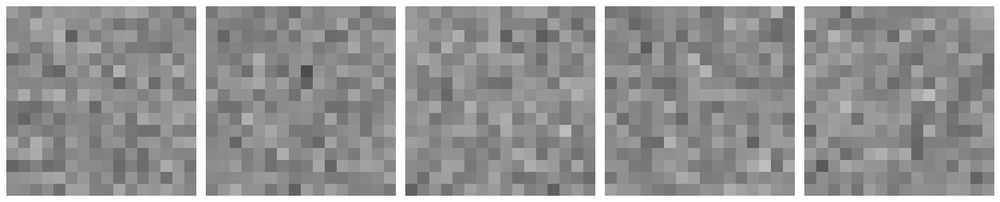

Checking Gausianity of components of tensor of shape (5, 4, 16, 16)...
Gaussian(?) 0: mean=0.002584234345704317, std=0.9250749945640564; 2-sided Χ² probability for the normality hypothesis: 0.7002262439501447
Gaussian(?) 1: mean=-0.05611269176006317, std=0.9227308034896851; 2-sided Χ² probability for the normality hypothesis: 0.009140412211227288
Gaussian(?) 2: mean=0.04864557832479477, std=0.9525279998779297; 2-sided Χ² probability for the normality hypothesis: 0.5352955747634406
Gaussian(?) 3: mean=-0.03733936324715614, std=0.9145646095275879; 2-sided Χ² probability for the normality hypothesis: 0.5146588639286964
Gaussian(?) 4: mean=-0.006655098404735327, std=0.937414288520813; 2-sided Χ² probability for the normality hypothesis: 0.8521104773133983


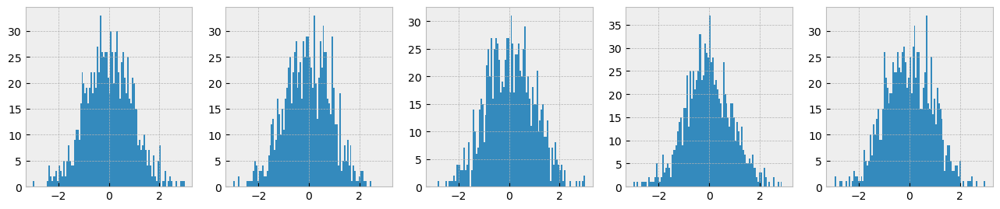


################ Inverted Gaussians of latents of latrunculin_B_high_conc samples (mean over 4 channels):


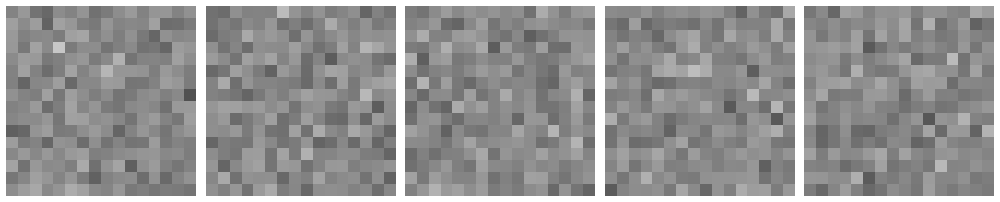

Checking Gausianity of components of tensor of shape (5, 4, 16, 16)...
Gaussian(?) 0: mean=0.011616320349276066, std=0.9275084137916565; 2-sided Χ² probability for the normality hypothesis: 0.9486088902399493
Gaussian(?) 1: mean=-0.021887419745326042, std=0.9188480973243713; 2-sided Χ² probability for the normality hypothesis: 0.0324973808178451
Gaussian(?) 2: mean=-0.0005943672731518745, std=0.9147765040397644; 2-sided Χ² probability for the normality hypothesis: 0.8053373773048444
Gaussian(?) 3: mean=0.020337115973234177, std=0.8869588375091553; 2-sided Χ² probability for the normality hypothesis: 0.6537198692863022
Gaussian(?) 4: mean=-0.0012926273047924042, std=0.9303372502326965; 2-sided Χ² probability for the normality hypothesis: 0.1457556444200359


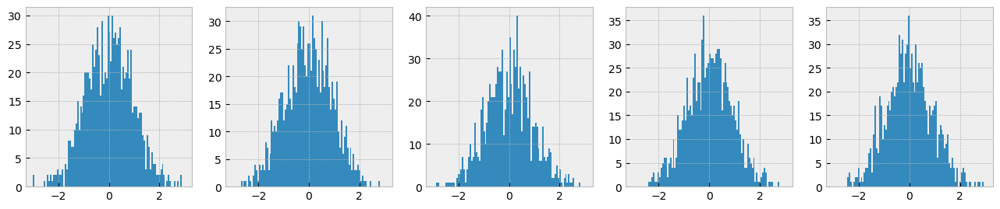

In [32]:
for sel_cl in selected_classes:
    print(
        f"\n################ Inverted Gaussians of latents of {sel_cl} samples (mean over 4 channels):"
    )
    print_grid(sel_samples[sel_cl]["SD_Gaussian_to_show_mean"])
    check_Gaussianity(sel_samples[sel_cl]["SD_Gaussian"])


Gaussianity check per-channel:

Checking Gausianity of components of tensor of shape (4, 16, 16)...
Gaussian(?) 0: mean=0.01564205065369606, std=0.9444909691810608; 2-sided Χ² probability for the normality hypothesis: 0.4712625511668963
Gaussian(?) 1: mean=-0.04399260878562927, std=0.9391712546348572; 2-sided Χ² probability for the normality hypothesis: 0.1959069305534689
Gaussian(?) 2: mean=0.0682268813252449, std=0.9121583104133606; 2-sided Χ² probability for the normality hypothesis: 0.5811057740770886
Gaussian(?) 3: mean=-0.029539378359913826, std=0.9051370024681091; 2-sided Χ² probability for the normality hypothesis: 0.3156569582630941


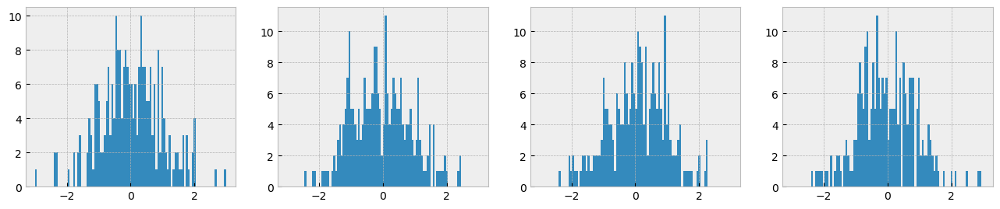

In [33]:
check_Gaussianity(sel_samples["DMSO"]["SD_Gaussian"][0])

The latents are often "not Gaussian"!

For reference:

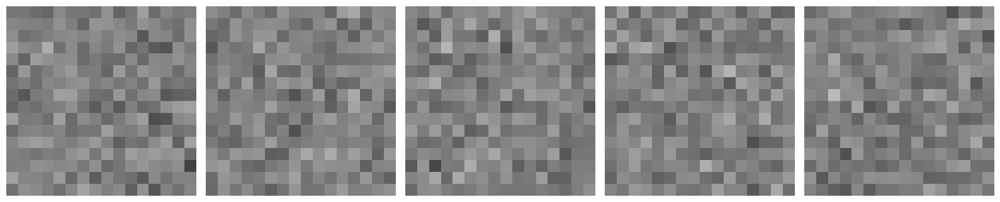

In [34]:
gauss_test = torch.randn_like(sel_samples[sel_cl]["SD_Gaussian"])
print_grid(tensor_to_PIL(gauss_test))

Checking Gausianity of components of tensor of shape (5, 4, 16, 16)...
Gaussian(?) 0: mean=-0.01274840533733368, std=0.9908007979393005; 2-sided Χ² probability for the normality hypothesis: 0.20498987635237031
Gaussian(?) 1: mean=0.011651389300823212, std=1.0191706418991089; 2-sided Χ² probability for the normality hypothesis: 0.363710178809995
Gaussian(?) 2: mean=0.016847888007760048, std=1.0107709169387817; 2-sided Χ² probability for the normality hypothesis: 0.6398096027622432
Gaussian(?) 3: mean=-0.0019718827679753304, std=1.0095207691192627; 2-sided Χ² probability for the normality hypothesis: 0.9595684910219918
Gaussian(?) 4: mean=-0.0463944748044014, std=1.0148741006851196; 2-sided Χ² probability for the normality hypothesis: 0.7864772292863245


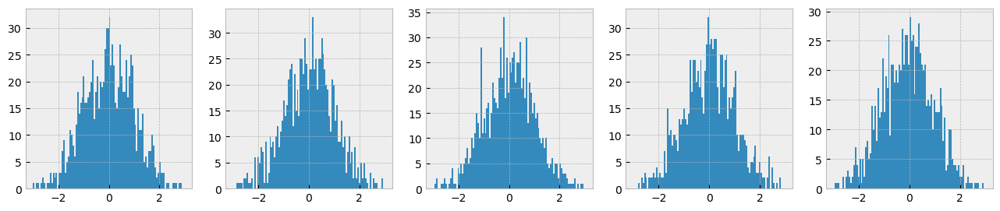

In [35]:
check_Gaussianity(gauss_test)

Note that the test is quite inappropriate to our setting as `scipy.stats.normaltest` performs the test on the flattened array: any spatial struture is thus lost. It appears that the images of high drug concentrations –usually with an important foreground-background delta– still sometimes leak quite some spatial information in the Gaussians.

### Obtain inverted Gaussians for DDIM

In [36]:
print(f"Number of training steps: {DDIM_noise_scheduler.config.num_train_timesteps}")


Number of training steps: 3000


In [37]:
# higher values give much better results (but take longer)
nb_noising_iter = 100

In [38]:
# should be in the range [1; scheduler.timesteps.max() + 1] (as scheduler.timesteps starts at zero)
assert nb_noising_iter <= DDIM_noise_scheduler.timesteps.max().item() + 1

DDIM_noise_scheduler.set_timesteps(nb_noising_iter)

# essentially, the inversion should follow the exact same discetization
# as the "forward" pass
DDIM_inv_scheduler: DDIMInverseScheduler = DDIMInverseScheduler.from_config(
    DDIM_noise_scheduler.config,
)
DDIM_inv_scheduler.set_timesteps(nb_noising_iter)

In [39]:
assert (reversed(DDIM_inv_scheduler.timesteps) == DDIM_noise_scheduler.timesteps).all()


In [40]:
DDIM_noise_scheduler

DDIMScheduler {
  "_class_name": "DDIMScheduler",
  "_diffusers_version": "0.18.2",
  "beta_end": 0.02,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.0001,
  "clip_sample": true,
  "clip_sample_range": 1.0,
  "dynamic_thresholding_ratio": 0.995,
  "num_train_timesteps": 3000,
  "prediction_type": "v_prediction",
  "rescale_betas_zero_snr": true,
  "sample_max_value": 1.0,
  "set_alpha_to_one": true,
  "steps_offset": 0,
  "thresholding": false,
  "timestep_spacing": "leading",
  "trained_betas": null
}

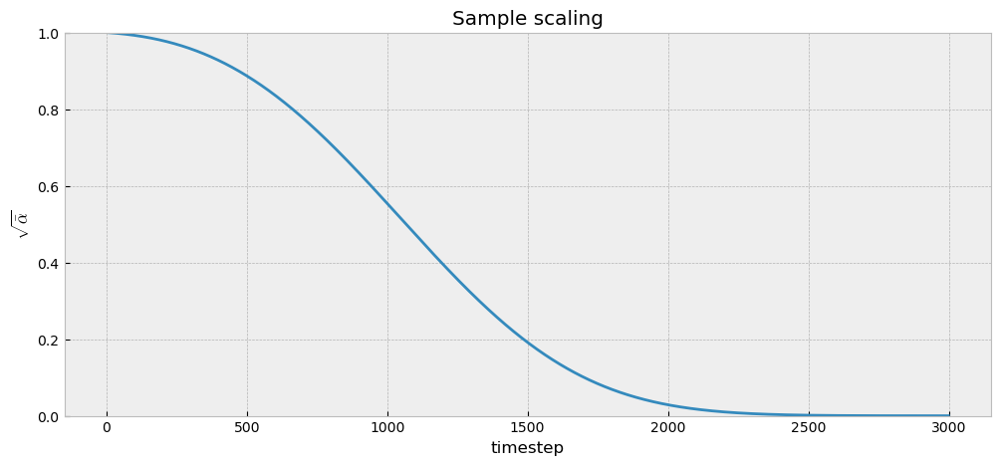

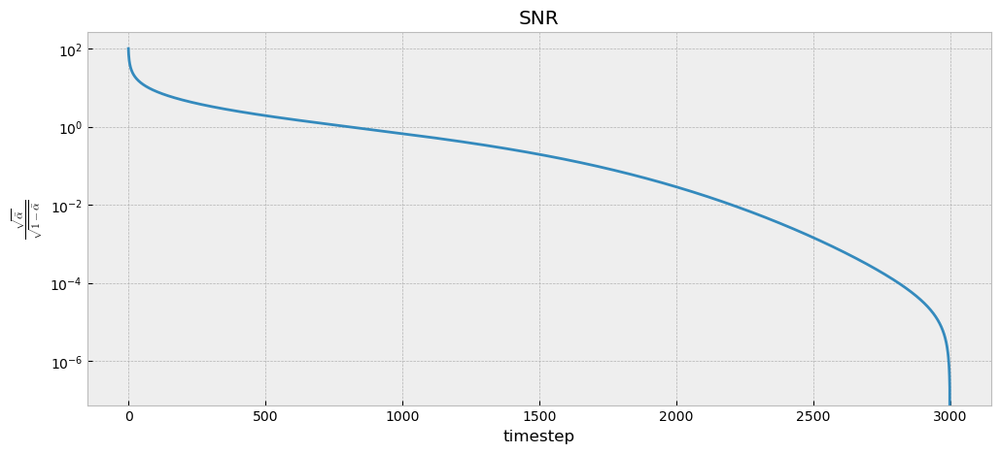

In [41]:
plt.figure(figsize=(12, 5))
plt.plot(np.sqrt(DDIM_noise_scheduler.alphas_cumprod))
plt.xlabel("timestep")
plt.ylabel(r"$\sqrt{\bar{\alpha}}$")
plt.ylim(0, 1)
plt.title("Sample scaling")
plt.show()

plt.figure(figsize=(12, 5))
plt.plot(
    np.sqrt(DDIM_noise_scheduler.alphas_cumprod)
    / np.sqrt(1 - DDIM_noise_scheduler.alphas_cumprod)
)
plt.xlabel("timestep")
plt.ylabel(r"$\frac{\sqrt{\bar{\alpha}}}{\sqrt{1 - \bar{\alpha}}}$")
plt.yscale("log")
plt.title("SNR")
plt.show()


In [42]:
with torch.no_grad():
    # get the latent representation of the sample
    gauss = torch.cat([sel_samples[sel_cl]["sample"] for sel_cl in selected_classes])
    cl_idx = torch.cat(
        [
            torch.stack([sel_samples[sel_cl]["class_idx"]] * nb_samples_per_class)
            for sel_cl in selected_classes
        ]
    ).long()

    # invert the diffeq
    for t in tqdm(
        DDIM_inv_scheduler.timesteps,
        desc="Inverting latents to Gaussian space...",
        leave=False,
    ):
        model_output = DDIM_denoiser(gauss, t, cl_idx).sample

        gauss = DDIM_inv_scheduler.step(
            model_output,
            t,
            gauss,
        ).prev_sample

    # save
    gauss = torch.split(gauss, nb_samples_per_class)
    for cl_idx, sel_cl in enumerate(selected_classes):
        sel_samples[sel_cl]["DDIM_Gaussian"] = gauss[cl_idx]
        tmp_normalized = gauss[cl_idx] - gauss[cl_idx].min()
        tmp_normalized /= tmp_normalized.max()
        tmp_normalized = tmp_normalized * 2 - 1
        sel_samples[sel_cl]["DDIM_Gaussian_to_show"] = tensor_to_PIL(tmp_normalized)


Inverting latents to Gaussian space...:   0%|          | 0/100 [00:00<?, ?it/s]


################ Inverted Gaussians of DMSO samples:


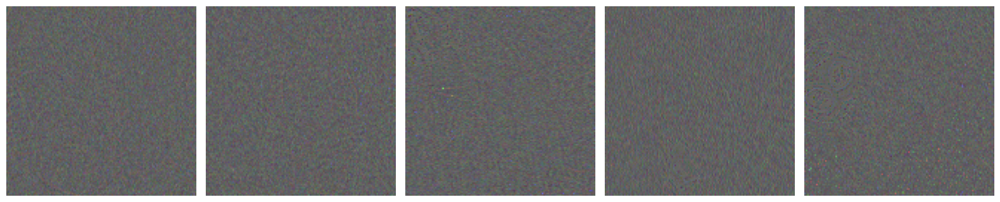

Checking Gausianity of components of tensor of shape (5, 3, 128, 128)...
Gaussian(?) 0: mean=-0.0003505176864564419, std=0.9356569051742554; 2-sided Χ² probability for the normality hypothesis: 3.138095945222059e-101
Gaussian(?) 1: mean=-0.0017116363160312176, std=0.9325153827667236; 2-sided Χ² probability for the normality hypothesis: 0.0
Gaussian(?) 2: mean=0.0034339111298322678, std=0.9253509640693665; 2-sided Χ² probability for the normality hypothesis: 0.0
Gaussian(?) 3: mean=-0.0016376541461795568, std=0.9486686587333679; 2-sided Χ² probability for the normality hypothesis: 3.345659936083044e-26
Gaussian(?) 4: mean=0.00028955121524631977, std=0.9510293006896973; 2-sided Χ² probability for the normality hypothesis: 0.0


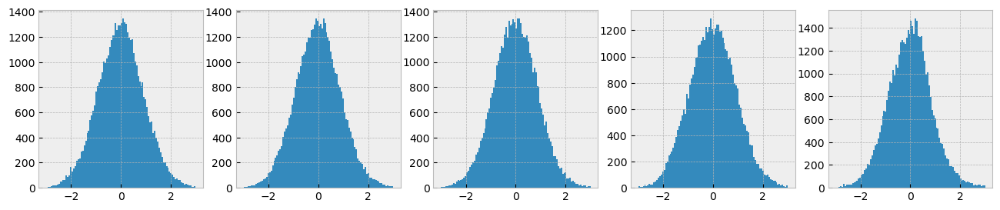


################ Inverted Gaussians of latrunculin_B_high_conc samples:


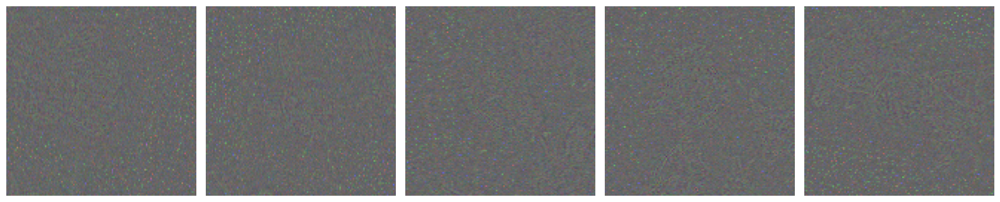

Checking Gausianity of components of tensor of shape (5, 3, 128, 128)...
Gaussian(?) 0: mean=0.006328684277832508, std=0.9676843881607056; 2-sided Χ² probability for the normality hypothesis: 0.0
Gaussian(?) 1: mean=0.000523302995134145, std=0.9794384837150574; 2-sided Χ² probability for the normality hypothesis: 0.0
Gaussian(?) 2: mean=0.006316845770925283, std=0.9703603386878967; 2-sided Χ² probability for the normality hypothesis: 0.0
Gaussian(?) 3: mean=0.006708126049488783, std=0.970497727394104; 2-sided Χ² probability for the normality hypothesis: 0.0
Gaussian(?) 4: mean=0.003288632957264781, std=0.9716939330101013; 2-sided Χ² probability for the normality hypothesis: 0.0


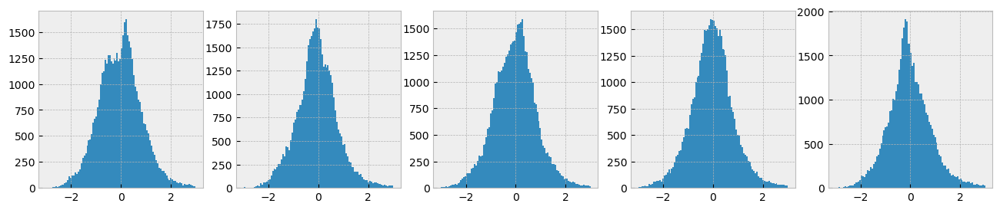

In [43]:
for sel_cl in selected_classes:
    print(f"\n################ Inverted Gaussians of {sel_cl} samples:")
    print_grid(sel_samples[sel_cl]["DDIM_Gaussian_to_show"])
    check_Gaussianity(sel_samples[sel_cl]["DDIM_Gaussian"])

## Regenerate

### First the latents for Stable Diffusion

In [44]:
with torch.no_grad():
    # get the Gaussian of the latents
    gauss = torch.cat(
        [sel_samples[sel_cl]["SD_Gaussian"] for sel_cl in selected_classes]
    )
    inv_latent = gauss.clone().detach()

    # get the embedding for each class
    cl_idxes = [sel_samples[sel_cl]["class_idx"] for sel_cl in selected_classes]
    cl_embed = torch.cat(
        [
            SD_class_encoder(cl_idx).repeat(nb_samples_per_class, 1)
            for cl_idx in cl_idxes
        ]
    )

    # hack to match the expected encoder_hidden_states shape
    (bs, ed) = cl_embed.shape
    cl_embed = cl_embed.reshape(bs, 1, ed)
    padding = torch.zeros_like(cl_embed).repeat(1, 76, 1).to(cl_embed.device)
    cl_embed = torch.cat([cl_embed, padding], dim=1)

    # reconstruct latents
    for t in tqdm(
        SD_noise_scheduler.timesteps,
        desc="Regenerating latent vector...",
        leave=False,
    ):
        model_output = SD_denoiser(inv_latent, t, encoder_hidden_states=cl_embed).sample

        inv_latent = SD_noise_scheduler.step(
            model_output,
            t,
            inv_latent,
        ).prev_sample

    # save
    inv_latent = torch.split(inv_latent, nb_samples_per_class)
    for cl_idx, sel_cl in enumerate(selected_classes):
        sel_samples[sel_cl]["SD_inv_latent"] = inv_latent[cl_idx]
        sel_samples[sel_cl]["SD_inv_latent_to_show_mean"] = tensor_to_PIL(
            inv_latent[cl_idx]
        )
        for c in range(4):
            sel_samples[sel_cl][f"SD_inv_latent_to_show_{c}"] = tensor_to_PIL(
                inv_latent[cl_idx], channel=c
            )

Regenerating latent vector...:   0%|          | 0/100 [00:00<?, ?it/s]

================================================ DMSO (index 0) ================================================
Original latents (showing the mean over the 4 channels):


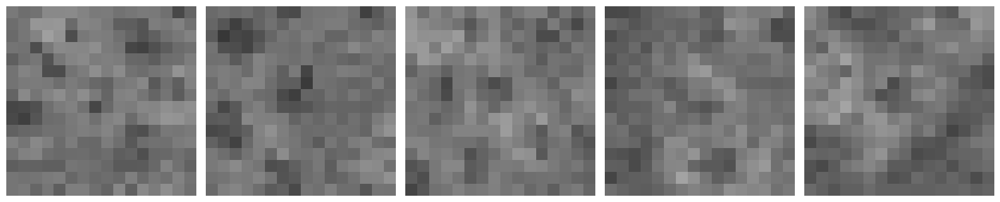

Inverted latents (showing the mean over the 4 channels):


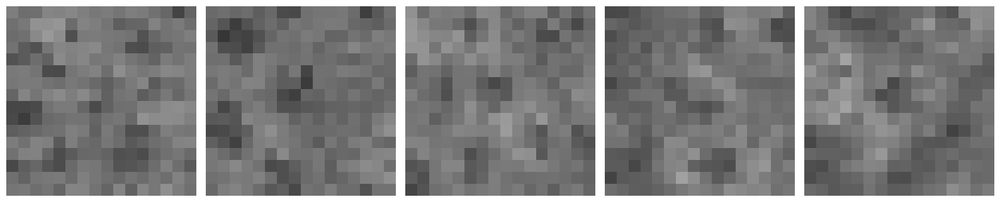

================================================ latrunculin_B_high_conc (index 1) ================================================
Original latents (showing the mean over the 4 channels):


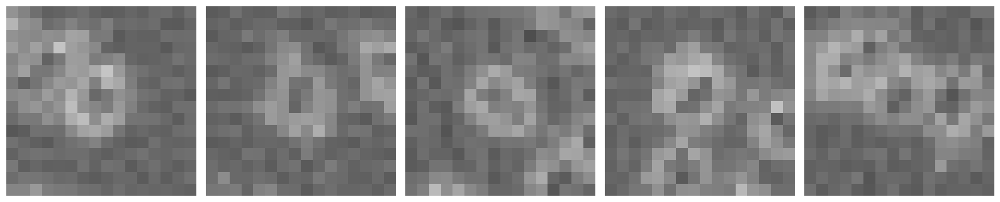

Inverted latents (showing the mean over the 4 channels):


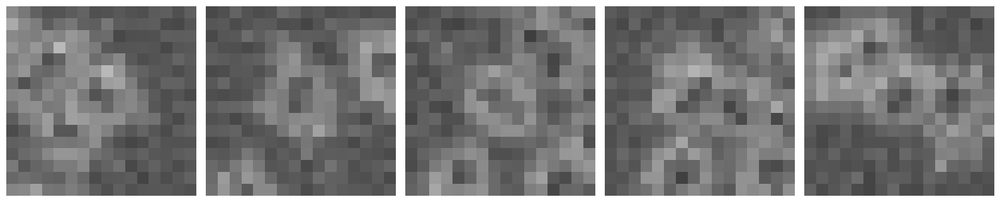

In [45]:
for sel_cl in selected_classes:
    print(
        f"================================================ {sel_cl} (index {class_to_index[sel_cl]}) ================================================"
    )
    print("Original latents (showing the mean over the 4 channels):")
    print_grid(sel_samples[sel_cl]["latent_to_show_mean"])
    print("Inverted latents (showing the mean over the 4 channels):")
    print_grid(sel_samples[sel_cl]["SD_inv_latent_to_show_mean"])

### Then the images

#### Stable Diffusion

In [46]:
with torch.no_grad():
    # get the inverted latents
    inv_latent = torch.cat(
        [sel_samples[sel_cl]["SD_inv_latent"] for sel_cl in selected_classes]
    )
    inv_sample = inv_latent.clone().detach()

    # decode the inverted latents into the reconstructed image
    inv_sample = SD_autoencoder.decode(
        inv_sample / SD_autoencoder.config.scaling_factor, return_dict=False
    )[0]

    # postprocess the image
    do_denormalize = [True] * inv_sample.shape[0]
    inv_sample_postproc = image_processor.postprocess(
        inv_sample, output_type="pt", do_denormalize=do_denormalize
    )
    inv_sample_to_show = image_processor.postprocess(
        inv_sample, output_type="pil", do_denormalize=do_denormalize
    )

    # save
    inv_sample_postproc = torch.split(inv_sample_postproc, nb_samples_per_class)
    inv_sample_to_show = [
        inv_sample_to_show[i * nb_samples_per_class : (i + 1) * nb_samples_per_class]
        for i in range(len(selected_classes))
    ]
    for cl_idx, sel_cl in enumerate(selected_classes):
        sel_samples[sel_cl]["SD_inv_sample"] = inv_sample_postproc[cl_idx]
        sel_samples[sel_cl]["SD_inv_sample_to_show"] = inv_sample_to_show[cl_idx]

Samples from DMSO (index 0):


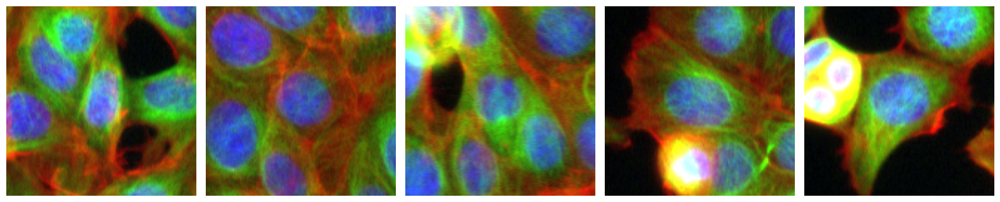

Reconstructed samples from inversion: :


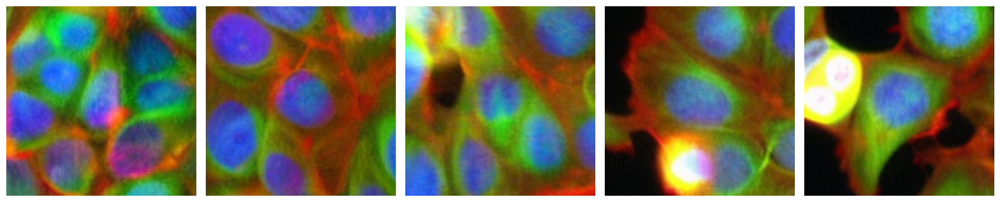

L2 reconstruction error: 178.8001708984375
L2 reconstruction error: 163.69198608398438
L2 reconstruction error: 156.55113220214844
L2 reconstruction error: 175.41127014160156
L2 reconstruction error: 181.78768920898438


Samples from latrunculin_B_high_conc (index 1):


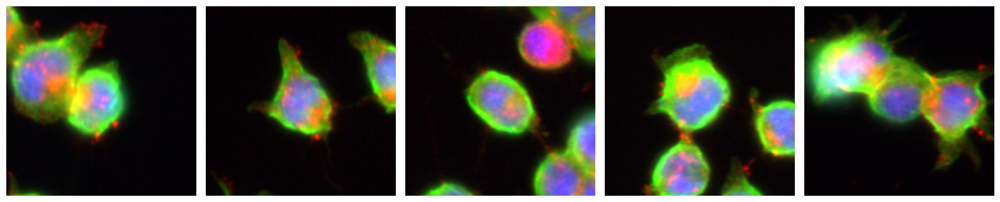

Reconstructed samples from inversion: :


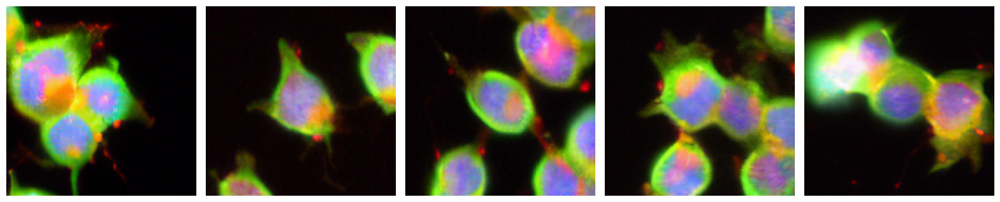

L2 reconstruction error: 211.55833435058594
L2 reconstruction error: 216.29490661621094
L2 reconstruction error: 211.00379943847656
L2 reconstruction error: 217.37509155273438
L2 reconstruction error: 200.8765411376953




In [47]:
for sel_cl in selected_classes:
    print(f"Samples from {sel_cl} (index {class_to_index[sel_cl]}):")
    print_grid(sel_samples[sel_cl]["sample_to_show"])
    print(f"Reconstructed samples from inversion: :")
    print_grid(sel_samples[sel_cl]["SD_inv_sample_to_show"])
    for idx in range(nb_samples_per_class):
        diff = torch.linalg.norm(
            sel_samples[sel_cl]["SD_inv_sample"][idx]
            - sel_samples[sel_cl]["sample"][idx]
        ).item()
        print(f"L2 reconstruction error: {diff}")
    print("\n")

#### DDIM

In [48]:
with torch.no_grad():
    # get the Gaussian
    gauss = torch.cat(
        [sel_samples[sel_cl]["DDIM_Gaussian"] for sel_cl in selected_classes]
    )
    inv_sample = gauss.clone().detach()

    # get the class indexx
    cl_idx = torch.cat(
        [
            torch.stack([sel_samples[sel_cl]["class_idx"]] * nb_samples_per_class)
            for sel_cl in selected_classes
        ]
    ).long()

    # reconstruct images
    for t in tqdm(
        DDIM_noise_scheduler.timesteps,
        desc="Regenerating sample...",
        leave=False,
    ):
        model_output = DDIM_denoiser(inv_sample, t, cl_idx).sample

        inv_sample = DDIM_noise_scheduler.step(
            model_output,
            t,
            inv_sample,
        ).prev_sample

    # save
    inv_sample = torch.split(inv_sample, nb_samples_per_class)
    for cl_idx, sel_cl in enumerate(selected_classes):
        sel_samples[sel_cl]["DDIM_inv_sample"] = inv_sample[cl_idx]
        sel_samples[sel_cl]["DDIM_inv_sample_to_show"] = tensor_to_PIL(
            inv_sample[cl_idx]
        )


Regenerating sample...:   0%|          | 0/100 [00:00<?, ?it/s]

Samples from DMSO (index 0):


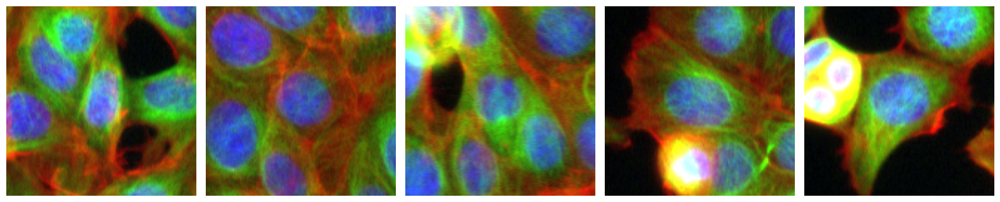

Reconstructed samples from inversion: :


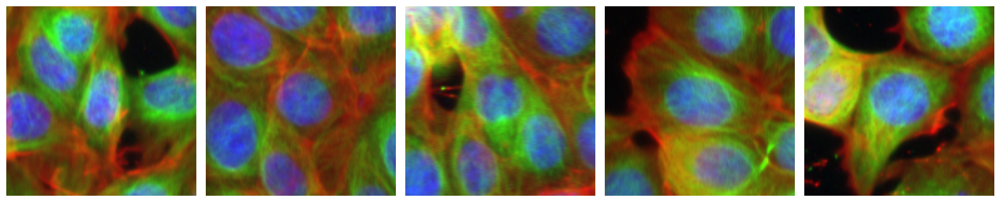

L2 reconstruction error: 11.067693710327148
L2 reconstruction error: 6.143413543701172
L2 reconstruction error: 18.128541946411133
L2 reconstruction error: 58.30875015258789
L2 reconstruction error: 61.27760696411133


Samples from latrunculin_B_high_conc (index 1):


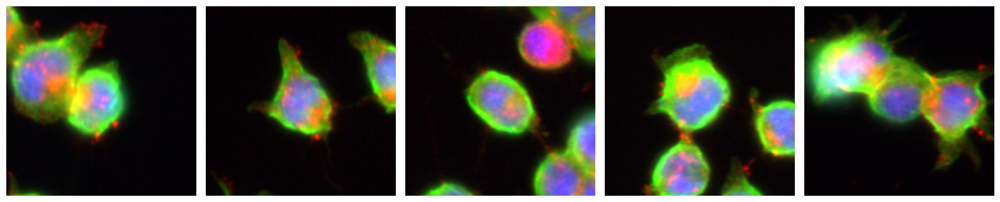

Reconstructed samples from inversion: :


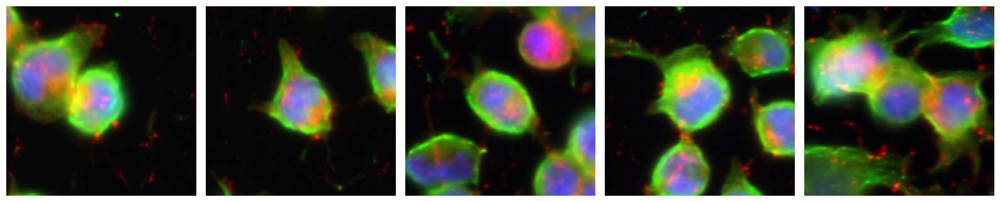

L2 reconstruction error: 12.579163551330566
L2 reconstruction error: 10.894632339477539
L2 reconstruction error: 43.87419128417969
L2 reconstruction error: 43.592491149902344
L2 reconstruction error: 55.95504379272461




In [49]:
for sel_cl in selected_classes:
    print(f"Samples from {sel_cl} (index {class_to_index[sel_cl]}):")
    print_grid(sel_samples[sel_cl]["sample_to_show"])
    print(f"Reconstructed samples from inversion: :")
    print_grid(sel_samples[sel_cl]["DDIM_inv_sample_to_show"])
    for idx in range(nb_samples_per_class):
        diff = torch.linalg.norm(
            sel_samples[sel_cl]["DDIM_inv_sample"][idx]
            - sel_samples[sel_cl]["sample"][idx]
        ).item()
        print(f"L2 reconstruction error: {diff}")
    print("\n")

For "reference":

In [50]:
torch.linalg.norm(torch.randn_like(sample[0]) - torch.randn_like(sample[0])).item()


314.65264892578125

## Effect of the length of the (de)noising trajectory

Study the effect of the discretization of the diffusion process on the reconstruction error. This might take some time!

Take a larger number of samples per class:

In [51]:
study_nb_samples_per_class = 100

In [52]:
nb_noising_iter_list = [
    5,
    10,
    # 30,
    # 50,
    # 75,
    # 100,
    # 200,
    # 250,
    # 300,
    # 500,
    # 1000,
    # 2000,
    # 3000,
]

### Stable Diffusion

In [53]:
reco_err_latent = dict.fromkeys(nb_noising_iter_list)
reco_err_sample = dict.fromkeys(nb_noising_iter_list)

In [54]:
with torch.no_grad():
    # take images at random
    tmp_list_samples = []

    for sel_cl in selected_classes:
        folder_path = Path(dataset_path, sel_cl)
        list_sample_names = random.sample(
            os.listdir(folder_path), study_nb_samples_per_class
        )
        for idx_sample, sample_name in enumerate(list_sample_names):
            sample_path = Path(folder_path, sample_name)
            sample = augmentations(Image.open(sample_path).convert("RGB")).to(device)
            sample.requires_grad_(False)
            tmp_list_samples.append(sample)

    # get a sample tensor
    sample = torch.stack(tmp_list_samples, dim=0)
    del tmp_list_samples

    # save it for later comparison
    sample_saved = sample.clone().detach().cpu()

    # encode it
    sample = SD_autoencoder.encode(sample).latent_dist.sample()
    # scale it
    sample *= SD_autoencoder.config.scaling_factor

    # save the latents for later comparison
    latent_saved = sample.clone().detach().cpu()

    # get the embedding for each class
    cl_idxes = [sel_samples[sel_cl]["class_idx"] for sel_cl in selected_classes]
    cl_embed = torch.cat(
        [
            SD_class_encoder(cl_idx).repeat(study_nb_samples_per_class, 1)
            for cl_idx in cl_idxes
        ]
    )

    # hack to match the expected encoder_hidden_states shape
    (bs, ed) = cl_embed.shape
    cl_embed = cl_embed.reshape(bs, 1, ed)
    padding = torch.zeros_like(cl_embed).repeat(1, 76, 1).to(cl_embed.device)
    cl_embed = torch.cat([cl_embed, padding], dim=1)

    # get its Gaussian twin for a range of trajectory lengths
    pbar = trange(2 * np.cumsum(nb_noising_iter_list)[-1])
    for nb_noising_iter in nb_noising_iter_list:
        # restart from the original sample
        sample = latent_saved.clone().detach().to(device)

        # prepare the schedulers
        SD_noise_scheduler.set_timesteps(nb_noising_iter)
        SD_inv_scheduler.set_timesteps(nb_noising_iter)

        # invert the diffeq to Gaussian space
        for t in SD_inv_scheduler.timesteps:
            model_output = SD_denoiser(sample, t, encoder_hidden_states=cl_embed).sample

            sample = SD_inv_scheduler.step(
                model_output,
                t,
                sample,
            ).prev_sample

            pbar.update()

        # reconstruct latents from Gaussian space
        for t in SD_noise_scheduler.timesteps:
            model_output = SD_denoiser(sample, t, encoder_hidden_states=cl_embed).sample

            sample = SD_noise_scheduler.step(
                model_output,
                t,
                sample,
            ).prev_sample

            pbar.update()

        # compute reconstruction error of the latents
        diff = torch.linalg.vector_norm(sample.cpu() - latent_saved, dim=(1, 2, 3))
        reco_err_latent[nb_noising_iter] = diff.cpu().numpy().tolist()

        # decode the inverted latents into the reconstructed image
        sample = SD_autoencoder.decode(
            sample / SD_autoencoder.config.scaling_factor, return_dict=False
        )[0]

        # postprocess the "image"
        do_denormalize = [True] * sample.shape[0]
        sample = image_processor.postprocess(
            sample, output_type="pt", do_denormalize=do_denormalize
        )

        # compute reconstruction error of the samples
        diff = torch.linalg.vector_norm(sample.cpu() - sample_saved, dim=(1, 2, 3))
        reco_err_sample[nb_noising_iter] = diff.cpu().numpy().tolist()

  0%|          | 0/30 [00:00<?, ?it/s]

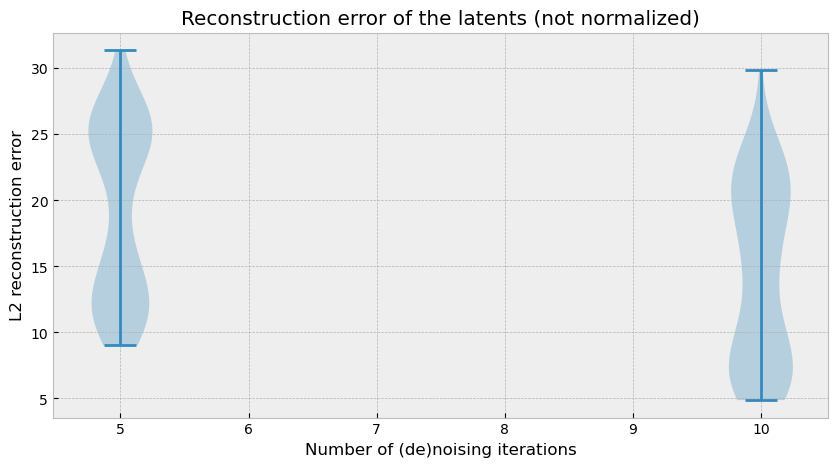

In [55]:
plt.figure(figsize=(10, 5))
plt.violinplot(
    [val for val in reco_err_latent.values()],
    nb_noising_iter_list,
)
plt.xlabel("Number of (de)noising iterations")
plt.ylabel("L2 reconstruction error")
plt.title("Reconstruction error of the latents (not normalized)")
plt.show()

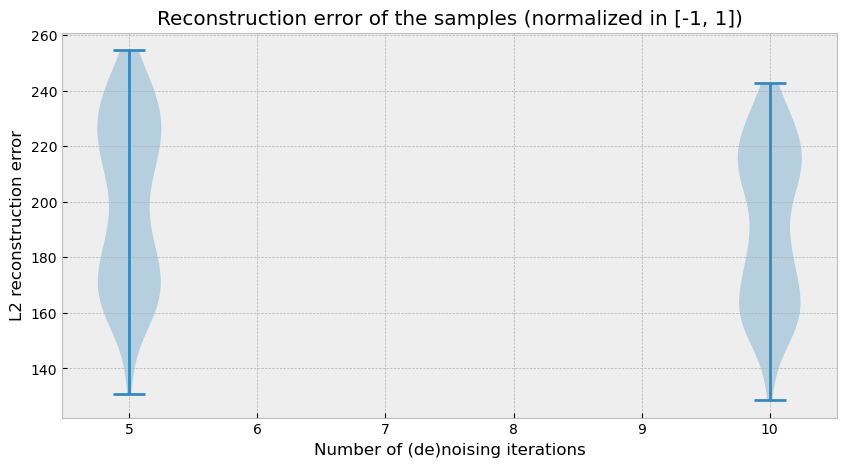

In [56]:
plt.figure(figsize=(10, 5))
plt.violinplot(
    [val for val in reco_err_sample.values()],
    nb_noising_iter_list,
)
plt.xlabel("Number of (de)noising iterations")
plt.ylabel("L2 reconstruction error")
plt.title("Reconstruction error of the samples (normalized in [-1, 1])")
plt.show()

# Linear interpolation along classes embeddings with custom guidance

In the absence of a *specifically enforced* structured class embedding space, a *meaningful* linear interpolation between class embeddings seems hopeless. This is not quite what is observed, however! Why? $\rightarrow$ TODO: research why `nn.Embedding` behaves nicely.

Nevertheless, there is simply no reason that samples positioned along a linear path in class embedding space should be close to each other in any way (try below with `guidance_loss_scale=0`).

$\rightarrow$ **We need to guide the generation process so that *some attributes* of the original image remain invariant along the class embedding interpolation.**

For now let's try to use a simple $L_p$ norm between the original image $x_0$ and the would-be generated one $\hat{x}_0$ as a guidance signal for the diffusion process. 

Of course a decently performant version would:
* force a meaningfull linear interpolation in class embedding space during training of this embedding (*e.g.* using intermediary drug concentrations) ; note that the linear interpolation seems –quite weirdly– to behave quite well already
* use a more advanced external model to capture these attributes we want to preserve 

Note that this could also be done trivially without interpolation, directly giving the full target class embedding.

## Guidance loss

In [57]:
def Lp_loss(
    x: torch.Tensor, y: torch.Tensor, p: int | float | Literal["inf", "-inf"] = 2
) -> torch.Tensor:
    """Returns the L_p norms of the flattened `(x[i] - y)` vectors for each `i` in the batch.

    Arguments
    ---------
    - x: `torch.Tensor`, shape `(N, C, H, W)`
    - y: `torch.Tensor`, shape `(C, H, W)`
    - p: `int | float | "inf" | "-inf"`, default `2`

    Returns
    -------
    `torch.linalg.vector_norm(x - y, dim=(1, 2, 3), ord=p)`, that is:
    ```
        torch.linalg.vector_norm(x[i] - y, ord=p) for i in range(N)
    ```
    """
    assert x.shape[1:] == y.shape, f"x.shape = {x.shape} != {y.shape} = y.shape"
    assert len(y.shape) == 3, f"y.shape = {y.shape} != (C, H, W)"
    return torch.linalg.vector_norm(x - y, dim=(1, 2, 3), ord=p)

## Hyperparameters

In [115]:
num_inference_steps = 50
nb_generated_samples = 50  # along the discretization trajectory
guidance_loss_scale = 0.001
# typically much lower (e.g. 0.01) for L1 than L2 (e.g. 0.1)
p = 2


In [116]:
# choose an original class & sample
orig_cl = "DMSO"
orig_sample_idx = 2

# choose a target class
target_cl = "latrunculin_B_high_conc"


In [60]:
# Class embeddings for Stable Diffusion
SD_orig_emb = SD_class_encoder(
    torch.tensor(class_to_index[orig_cl]).long().to(device)
).view(1, -1)
SD_target_emb = SD_class_encoder(
    torch.tensor(class_to_index[target_cl]).long().to(device)
).view(1, -1)

SD_orig_emb = hack_class_embedding(SD_orig_emb)
SD_target_emb = hack_class_embedding(SD_target_emb)

# Class embeddings for DDIM
DDIM_orig_emb = DDIM_denoiser.class_embedding(
    torch.tensor(class_to_index[orig_cl]).long().to(device)
)
DDIM_target_emb = DDIM_denoiser.class_embedding(
    torch.tensor(class_to_index[target_cl]).long().to(device)
)

2 possibilities for LDMs: 

0. Compute the guiding gradient in the latent space only, that is: between the latent representation of the being-translated image and the would-be final *latent*, or:
1. also take into account the decoding step, and compute the gradient of the distance between the being-translated *image* and the would-be, final (ie at t=0), decoded one

## Stable Diffusion: Latent space only

### Generate interpolated images

In [61]:
latent_to_show_list = []
image_to_show_list = []
latent_list = []
interp_traj = np.linspace(0, 1, nb_generated_samples)

batches: list[int] = [
    args.batch_size for i in range(nb_generated_samples // args.batch_size)
] + [nb_generated_samples % args.batch_size]

# set step values
SD_noise_scheduler.set_timesteps(num_inference_steps)

for i, actual_bs in enumerate(tqdm(batches, desc="Batch")):
    print(f"====================\nBatch {i + 1}/{len(batches)}")
    batch_idxes = range(i * args.batch_size, i * args.batch_size + batches[i])
    x_batch = interp_traj[batch_idxes]

    # start the denoising from the inverted gaussian
    latent = (
        sel_samples[orig_cl]["SD_Gaussian"][orig_sample_idx]
        .clone()
        .detach()
        .repeat(batches[i], 1, 1, 1)
    )

    # get interpolated class embedding
    class_embedding = [((1 - x) * SD_orig_emb + x * SD_target_emb) for x in x_batch]
    class_embedding = torch.cat(class_embedding)

    for j, t in enumerate(tqdm(SD_noise_scheduler.timesteps, leave=False)):
        # 0. require grad on image
        latent = latent.detach().requires_grad_()

        # 1. predict noise model_output
        model_output = SD_denoiser(
            sample=latent,
            timestep=t,
            encoder_hidden_states=class_embedding,
        ).sample

        # 2. get x_0 prediction
        x0_latent = SD_noise_scheduler.step(
            model_output,
            t,
            latent,
        ).pred_original_sample

        # 3. compute loss
        # each image in batch has its own loss with respect to the original sample
        # hence losses.shape = (batch_size,)
        losses = Lp_loss(x0_latent, sel_samples[orig_cl]["latent"][orig_sample_idx], p)
        if j % (num_inference_steps // 10) == 0:
            print(
                f"Timestep {j} | mean guidance loss: {round(losses.mean().item(), 3)}"
            )

        # 4. get gradient
        losses_seq = [losses[i] for i in range(batches[i])]
        guidance_grad = torch.autograd.grad(losses_seq, latent)[0]

        # 5. modify the image based on this gradient
        latent = (
            latent.detach().requires_grad_(False) - guidance_loss_scale * guidance_grad
        )

        # 6. x_t -> x_t-1
        latent = SD_noise_scheduler.step(
            model_output,
            t,
            latent,
        ).prev_sample

    latent_list.append(latent)

    latent_to_show = tensor_to_PIL(latent)
    if len(x_batch) == 1:
        latent_to_show = [latent_to_show]

    latent_to_show_list += latent_to_show

    with torch.no_grad():
        decoded_image = SD_autoencoder.decode(
            latent / SD_autoencoder.config.scaling_factor, return_dict=False
        )[0]

    # postprocess the image
    do_denormalize = [True] * decoded_image.shape[0]
    decoded_image = image_processor.postprocess(
        decoded_image, output_type="pil", do_denormalize=do_denormalize
    )

    image_to_show_list += decoded_image

Batch:   0%|          | 0/1 [00:00<?, ?it/s]

Batch 1/1


  0%|          | 0/50 [00:00<?, ?it/s]

Timestep 0 | mean guidance loss: 24.833
Timestep 5 | mean guidance loss: 23.349
Timestep 10 | mean guidance loss: 22.357
Timestep 15 | mean guidance loss: 21.429
Timestep 20 | mean guidance loss: 20.251
Timestep 25 | mean guidance loss: 19.003
Timestep 30 | mean guidance loss: 17.86
Timestep 35 | mean guidance loss: 16.74
Timestep 40 | mean guidance loss: 15.916
Timestep 45 | mean guidance loss: 15.256


In [62]:
gc.collect()
torch.cuda.empty_cache()
gc.collect()

0

### Visualize

In [63]:
save_video = False

In [64]:
px = 1 / plt.rcParams["figure.dpi"]  # pixel in inches
fig, ax = plt.subplots(figsize=(5, 5))

ax.imshow(image_to_show_list[0])  # show an initial one first

# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = [
    [ax.imshow(image, animated=True, interpolation=None)]
    for image in image_to_show_list
]

ax.axis("off")

ani = animation.ArtistAnimation(fig, ims, interval=10, blit=True, repeat=False)

# Save the animation
if save_video:
    save_path = "experiments/DMSO_vs_cyto30_cond_gen_interpolation/"
    video_name = f"class_translation_guidance_L_{p}_nb_steps{num_inference_steps}_guid_scale{guidance_loss_scale}"
    video_path = os.path.join(save_path, video_name)
    video_formats = ["mkv", "mp4"]
    for vid_format in video_formats:
        video_full_path = video_path + "." + vid_format
        if os.path.exists(video_full_path):
            timestamp = datetime.now().strftime("%Y-%m-%d-%H-%M-%S")
            warn(
                f"Video {video_full_path} already exists; writting to {video_path}-{timestamp}.{vid_format}"
            )
            ani.save(f"{video_path}-{timestamp}.{vid_format}", fps=5)
        else:
            ani.save(video_full_path, fps=5)

plt.close()

HTML(ani.to_jshtml())


Semantic conservation? Initial image for comparison:

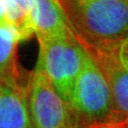

In [65]:
display(sel_samples[orig_cl]["sample_to_show"][orig_sample_idx])

## Stable Diffusion: Including image space

### Generate interpolated images

In [66]:
latent_to_show_list = []
image_to_show_list = []
latent_list = []
interp_traj = np.linspace(0, 1, nb_generated_samples)

batches: list[int] = [
    args.batch_size for i in range(nb_generated_samples // args.batch_size)
] + [nb_generated_samples % args.batch_size]

# set step values
SD_noise_scheduler.set_timesteps(num_inference_steps)

for i, actual_bs in enumerate(tqdm(batches, desc="Batch")):
    print(f"====================\nBatch {i + 1}/{len(batches)}")
    batch_idxes = range(i * args.batch_size, i * args.batch_size + batches[i])
    x_batch = interp_traj[batch_idxes]

    # start the denoising from the inverted gaussian
    latent = (
        sel_samples[orig_cl]["SD_Gaussian"][orig_sample_idx]
        .clone()
        .detach()
        .repeat(batches[i], 1, 1, 1)
    )

    # get interpolated class embedding
    class_embedding = [((1 - x) * SD_orig_emb + x * SD_target_emb) for x in x_batch]
    class_embedding = torch.cat(class_embedding)

    for j, t in enumerate(tqdm(SD_noise_scheduler.timesteps, leave=False)):
        # 0. require grad on image
        latent = latent.detach().requires_grad_()

        # 1. predict noise model_output
        model_output = SD_denoiser(
            sample=latent,
            timestep=t,
            encoder_hidden_states=class_embedding,
        ).sample

        # 2. get x_0 prediction
        x0_latent = SD_noise_scheduler.step(
            model_output,
            t,
            latent,
        ).pred_original_sample

        # 3. decode it & post_process it
        decoded_image = SD_autoencoder.decode(
            x0_latent / SD_autoencoder.config.scaling_factor,
            return_dict=False,
        )[0]

        decoded_image = image_processor.postprocess(
            decoded_image, output_type="pt", do_denormalize=[True] * latent.shape[0]
        )

        # 4. compute loss
        # each image in batch has its own loss with respect to the original sample
        # hence losses.shape = (batch_size,)
        losses = Lp_loss(
            decoded_image, sel_samples[orig_cl]["sample"][orig_sample_idx], p
        )
        if j % (num_inference_steps // 10) == 0:
            print(
                f"Timestep {j} | mean guidance loss: {round(losses.mean().item(), 3)}"
            )

        # 5. get gradient
        losses_seq = [losses[i] for i in range(batches[i])]
        guidance_grad = torch.autograd.grad(losses_seq, latent)[0]

        # 6. modify the image based on this gradient
        latent = (
            latent.detach().requires_grad_(False) - guidance_loss_scale * guidance_grad
        )

        # 7. x_t -> x_t-1
        latent = SD_noise_scheduler.step(
            model_output,
            t,
            latent,
        ).prev_sample

    latent_list.append(latent)

    latent_to_show = tensor_to_PIL(latent)
    if len(x_batch) == 1:
        latent_to_show = [latent_to_show]

    latent_to_show_list += latent_to_show

    with torch.no_grad():
        decoded_image = SD_autoencoder.decode(
            latent / SD_autoencoder.config.scaling_factor, return_dict=False
        )[0]

    # postprocess the image
    do_denormalize = [True] * decoded_image.shape[0]
    decoded_image = image_processor.postprocess(
        decoded_image, output_type="pil", do_denormalize=do_denormalize
    )

    image_to_show_list += decoded_image

Batch:   0%|          | 0/1 [00:00<?, ?it/s]

Batch 1/1


  0%|          | 0/50 [00:00<?, ?it/s]

Timestep 0 | mean guidance loss: 158.412
Timestep 5 | mean guidance loss: 158.398
Timestep 10 | mean guidance loss: 158.227
Timestep 15 | mean guidance loss: 158.279
Timestep 20 | mean guidance loss: 156.139
Timestep 25 | mean guidance loss: 154.424
Timestep 30 | mean guidance loss: 153.154
Timestep 35 | mean guidance loss: 152.647
Timestep 40 | mean guidance loss: 152.21
Timestep 45 | mean guidance loss: 151.85


In [67]:
gc.collect()
torch.cuda.empty_cache()
gc.collect()

0

### Visualize

In [68]:
save_video = False

In [69]:
px = 1 / plt.rcParams["figure.dpi"]  # pixel in inches
fig, ax = plt.subplots(figsize=(5, 5))

ax.imshow(image_to_show_list[0])  # show an initial one first

# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = [
    [ax.imshow(image, animated=True, interpolation=None)]
    for image in image_to_show_list
]

ax.axis("off")

ani = animation.ArtistAnimation(fig, ims, interval=10, blit=True, repeat=False)

# Save the animation
if save_video:
    save_path = "experiments/DMSO_vs_cyto30_cond_gen_interpolation/"
    video_name = f"class_translation_guidance_L_{p}_nb_steps{num_inference_steps}_guid_scale{guidance_loss_scale}"
    video_path = os.path.join(save_path, video_name)
    video_formats = ["mkv", "mp4"]
    for vid_format in video_formats:
        video_full_path = video_path + "." + vid_format
        if os.path.exists(video_full_path):
            timestamp = datetime.now().strftime("%Y-%m-%d-%H-%M-%S")
            warn(
                f"Video {video_full_path} already exists; writting to {video_path}-{timestamp}.{vid_format}"
            )
            ani.save(f"{video_path}-{timestamp}.{vid_format}", fps=5)
        else:
            ani.save(video_full_path, fps=5)

plt.close()

HTML(ani.to_jshtml())


Semantic conservation? Initial image for comparison:

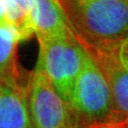

In [70]:
display(sel_samples[orig_cl]["sample_to_show"][orig_sample_idx])

## DDIM

In [117]:
image_to_show_list = []
tensor_list = []
interp_traj = np.linspace(0, 1, nb_generated_samples)

custom_bs = args.batch_size // 4

batches: list[int] = [custom_bs for i in range(nb_generated_samples // custom_bs)] + [
    nb_generated_samples % custom_bs
]

# set step values
DDIM_noise_scheduler.set_timesteps(num_inference_steps)

for i, actual_bs in enumerate(tqdm(batches, desc="Batch")):
    print(f"====================\nBatch {i + 1}/{len(batches)}")
    batch_idxes = range(i * custom_bs, i * custom_bs + batches[i])
    x_batch = interp_traj[batch_idxes]

    image = (
        sel_samples[orig_cl]["DDIM_Gaussian"][orig_sample_idx]
        .clone()
        .detach()
        .repeat(batches[i], 1, 1, 1)
    )

    # get interpolated class embedding
    class_embedding = [((1 - x) * DDIM_orig_emb + x * DDIM_target_emb) for x in x_batch]
    class_embedding = torch.stack(class_embedding)

    for j, t in enumerate(tqdm(DDIM_noise_scheduler.timesteps, leave=False)):
        # 0. require grad on image
        image = image.detach().requires_grad_()

        # 1. predict noise model_output
        model_output = DDIM_denoiser(
            sample=image, timestep=t, class_labels=None, class_emb=class_embedding
        ).sample

        # 2. get x_0 prediction
        x0 = DDIM_noise_scheduler.step(
            model_output,
            t,
            image,
        ).pred_original_sample

        # 3. compute loss
        # each image in batch has its own loss with respect to the original sample
        # hence losses.shape = (batch_size,)
        losses = Lp_loss(x0, sel_samples[orig_cl]["sample"][orig_sample_idx], p)
        if j % (num_inference_steps // 10) == 0:
            print(
                f"Timestep {j} | mean guidance loss: {round(losses.mean().item(), 3)}"
            )

        # 4. get gradient
        losses_seq = [losses[i] for i in range(batches[i])]
        guidance_grad = torch.autograd.grad(losses_seq, image)[0]

        # 5. modify the image based on this gradient
        image = image.detach() - guidance_loss_scale * guidance_grad

        # 6. x_t -> x_t-1
        image = DDIM_noise_scheduler.step(
            model_output,
            t,
            image,
        ).prev_sample

    tensor_list.append(image)

    image_to_show = tensor_to_PIL(image)
    if len(x_batch) == 1:
        image_to_show = [image_to_show]

    image_to_show_list += image_to_show


Batch:   0%|          | 0/1 [00:00<?, ?it/s]

Batch 1/1


  0%|          | 0/50 [00:00<?, ?it/s]

Timestep 0 | mean guidance loss: 116.175
Timestep 5 | mean guidance loss: 116.062
Timestep 10 | mean guidance loss: 111.262
Timestep 15 | mean guidance loss: 99.564
Timestep 20 | mean guidance loss: 88.246
Timestep 25 | mean guidance loss: 80.806
Timestep 30 | mean guidance loss: 78.904
Timestep 35 | mean guidance loss: 77.467
Timestep 40 | mean guidance loss: 75.498
Timestep 45 | mean guidance loss: 73.812
Warning in tensor_to_PIL: tensor.min() = -0.9701884984970093 != -1


In [118]:
gc.collect()
torch.cuda.empty_cache()
gc.collect()

0

### Visualize

In [119]:
save_video = False

In [120]:
px = 1 / plt.rcParams["figure.dpi"]  # pixel in inches
fig, ax = plt.subplots(figsize=(5, 5))

ax.imshow(image_to_show_list[0])  # show an initial one first

# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = [
    [ax.imshow(image, animated=True, interpolation=None)]
    for image in image_to_show_list
]

ax.axis("off")

ani = animation.ArtistAnimation(fig, ims, interval=10, blit=True, repeat=False)

# Save the animation
if save_video:
    save_path = "experiments/DMSO_vs_cyto30_cond_gen_interpolation/"
    video_name = f"class_translation_guidance_L_{p}_nb_steps{num_inference_steps}_guid_scale{guidance_loss_scale}"
    video_path = os.path.join(save_path, video_name)
    video_formats = ["mkv", "mp4"]
    for vid_format in video_formats:
        video_full_path = video_path + "." + vid_format
        if os.path.exists(video_full_path):
            timestamp = datetime.now().strftime("%Y-%m-%d-%H-%M-%S")
            warn(
                f"Video {video_full_path} already exists; writting to {video_path}-{timestamp}.{vid_format}"
            )
            ani.save(f"{video_path}-{timestamp}.{vid_format}", fps=5)
        else:
            ani.save(video_full_path, fps=5)

plt.close()

HTML(ani.to_jshtml())


Semantic conservation? Initial image for comparison:

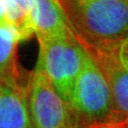

In [121]:
display(sel_samples[orig_cl]["sample_to_show"][orig_sample_idx])

# Classifier-free guidance

Instead of forcing some invariants with custom guidance *at inference time* (which is **costly**, because of the loss/image gradient computation at play), one could simply try to control the *strength* of the conditioning to see how the generated image evolves, *but without relying on acting on the class embedding space*.

Enters [Classifier-Free Diffusion Guidance](https://arxiv.org/abs/2207.12598).  
In the absence of a pretrained classifier, one can train a model using classifier-free guidance. Idea: jointly train a conditional and an unconditional version of the model and combine their weighted prediction as:
$$
    \hat{y}_\text{final} = (1-\omega) \cdot \hat{y}_{\text{uncond}} + \omega \cdot \hat{y}_{\text{uncond}}
$$

Here the class embedding is fixed and only the guidance strength varies.

Additionally, one could first start a "normal" inference process (that is without performing any kind of class translation) for the first few steps, and only then guide the generation.

## Hyperparameters

In [122]:
# num_inference_steps is the total number of denoising steps from latent space to image space
num_inference_steps = 100

nb_generated_samples = 50

guidance_scale_list = torch.linspace(1, 10, nb_generated_samples).to(device)

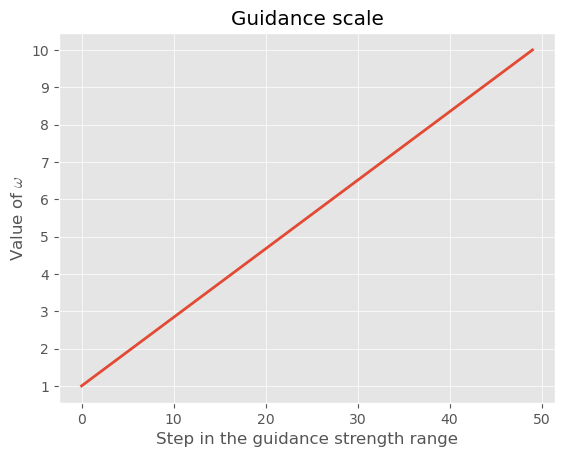

In [123]:
plt.style.use("ggplot")
plt.plot(guidance_scale_list.cpu().numpy())
plt.title("Guidance scale")
plt.xlabel("Step in the guidance strength range")
plt.ylabel(r"Value of $\omega$")
plt.yticks(range(1, 11))
plt.show()


## Generate samples

Starting from a real sample:

In [124]:
orig_cl = "DMSO"
idx_sample = 3

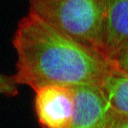

In [125]:
display(sel_samples[orig_cl]["sample_to_show"][idx_sample])


Choose target class & get class indexes:

In [126]:
target_class = "latrunculin_B_high_conc"

In [127]:
orig_class_idx = torch.tensor(dataset.class_to_idx[orig_cl], device=device).long()
print("orig_class_idx:", orig_class_idx)

target_class_idx = torch.tensor(
    dataset.class_to_idx[target_class], device=device
).long()
print("target_class_idx:", target_class_idx)

assert orig_cl in selected_classes and target_class in selected_classes

orig_class_idx: tensor(0, device='cuda:0')
target_class_idx: tensor(1, device='cuda:0')


### Stable Diffusion

**Currently the generation does not start from an inverted latent Gausian but from the "forwardly noised" (latent representation of the) initial sample.**

Start from a slightly denoised version of the original image, with full conditional generation

In [128]:
# orig_class_embedding = SD_class_encoder(orig_class_idx).view(1, -1)
# orig_class_embedding = hack_class_embedding(orig_class_embedding)

In [129]:
# # set number of total denoising steps
# SD_noise_scheduler.set_timesteps(num_inference_steps)

# nb_img_shown = 20
# denoising_traj_img_list = []
# denoising_traj_latents = {}
# denoising_traj_times_shown = []

# with torch.no_grad():
#     latent = (
#         sel_samples[orig_cl]["SD_Gaussian"][idx_sample].clone().detach().unsqueeze(0)
#     )

#     # denoise the inverted latent for the first `num_denoising_steps` steps
#     for idx, t in enumerate(tqdm(SD_noise_scheduler.timesteps)):
#         cond_output = SD_denoiser(
#             sample=latent,
#             timestep=t,
#             encoder_hidden_states=orig_class_embedding,
#         ).sample

#         latent = SD_noise_scheduler.step(
#             cond_output,
#             t,
#             latent,
#         ).prev_sample

#         if idx % (len(SD_noise_scheduler.timesteps) // nb_img_shown) == 0:
#             denoising_traj_times_shown.append(
#                 f"timestep: {t.item()}\nnb_denoising_steps: {idx}"
#             )
#             denoising_traj_latents[idx] = latent.clone()
#             denoising_traj_img_list.append(tensor_to_PIL(latent))

In [130]:
# print_grid(denoising_traj_img_list, titles=denoising_traj_times_shown)


In [131]:
# # num_denoising_steps is the number of denoising steps use to slightly denoise the original image
# # before starting the guided inference; it should be < num_inference_steps
# num_denoising_steps = 40
# assert num_denoising_steps < num_inference_steps

In [132]:
# starting_latent = denoising_traj_latents[num_denoising_steps]
# print("Starting point for the guided generation:")
# display(tensor_to_PIL(starting_latent).resize((256, 256), Image.NEAREST))

Generate:

In [133]:
strength = 0.3


In [134]:
images_to_show_list = []

SD_pipeline.set_progress_bar_config(disable=True)

nb_first_full_batches = ceil(nb_generated_samples / args.batch_size) - 1
batches: list[int] = [args.batch_size] * nb_first_full_batches
batches += [nb_generated_samples - args.batch_size * nb_first_full_batches]

with torch.no_grad():
    for i, actual_bs in enumerate(tqdm(batches, desc="Batch")):
        batch_idxes = range(i * args.batch_size, i * args.batch_size + batches[i])
        w_batch = guidance_scale_list[batch_idxes]

        # latent = starting_latent.clone().detach().repeat(batches[i], 1, 1, 1)
        start_image = (
            sel_samples[orig_cl]["sample"][idx_sample]
            .clone()
            .detach()
            .repeat(actual_bs, 1, 1, 1)
        )
        start_image /= 2
        start_image += 0.5

        # get *fixed*, *target* class embedding
        batch_target_class_embedding = target_class_idx.repeat(actual_bs, 1, 1)

        imgs = SD_pipeline(
            image=start_image,
            class_labels=target_class_idx.repeat(actual_bs),
            strength=strength,
            num_inference_steps=num_inference_steps,
            guidance_scale=w_batch,
            device=device,
        )

        images_to_show_list += imgs

Batch:   0%|          | 0/1 [00:00<?, ?it/s]

#### Visualize

In [135]:
save_video = False


In [136]:
px = 1 / plt.rcParams["figure.dpi"]  # pixel in inches
fig, ax = plt.subplots(figsize=(6, 6))

ax.imshow(images_to_show_list[0])  # show an initial one first

# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = [
    [ax.imshow(image, animated=True, interpolation=None)]
    for image in images_to_show_list
]

ax.axis("off")

ani = animation.ArtistAnimation(fig, ims, interval=10, blit=True, repeat=False)

# Save the animation
if save_video:
    save_path = "experiments/DMSO_vs_cytoB_translation_experiments/"
    video_name = f"classifier-free_gen_nb_steps{num_inference_steps}"
    video_path = os.path.join(save_path, video_name)
    video_formats = ["mkv", "mp4"]
    for vid_format in video_formats:
        video_full_path = video_path + "." + vid_format
        if os.path.exists(video_full_path):
            timestamp = datetime.now().strftime("%Y-%m-%d-%H-%M-%S")
            warn(
                f"Video {video_full_path} already exists; writting to {video_path}-{timestamp}.{vid_format}"
            )
            ani.save(f"{video_path}-{timestamp}.{vid_format}", fps=5)
        else:
            ani.save(video_full_path, fps=5)

plt.close()

HTML(ani.to_jshtml())


Note: no smoothness along the guidance factor dimension (quite expected).

For reference:

Original image


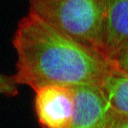

In [137]:
# print("Starting point for the guided generation:")
# display(
#     tensor_to_PIL(denoising_traj_latents[num_denoising_steps]).resize(
#         (128, 128), Image.NEAREST
#     )
# )
print("Original image")
display(sel_samples[orig_cl]["sample_to_show"][idx_sample])


### DDIM

Start from a slightly denoised version of the original image, with full conditional generation

In [138]:
# set number of total denoising steps
DDIM_noise_scheduler.set_timesteps(num_inference_steps)

nb_img_shown = 20


In [139]:
denoising_traj_img_list = []
denoising_traj_times_shown = []

with torch.no_grad():
    gauss = (
        sel_samples[orig_cl]["DDIM_Gaussian"][idx_sample]
        .clone()
        .detach()
        .view((1, 3, args.resolution, args.resolution))
    )

    # denoise the inverted Gaussian for the first `num_denoising_steps` steps
    for idx, t in enumerate(tqdm(DDIM_noise_scheduler.timesteps)):
        cond_output = DDIM_denoiser(gauss, t, class_labels=orig_class_idx).sample

        gauss = DDIM_noise_scheduler.step(
            cond_output,
            t,
            gauss,
        ).prev_sample

        if idx % (len(DDIM_noise_scheduler.timesteps) // nb_img_shown) == 0:
            denoising_traj_times_shown.append(
                f"timestep: {t.item()}\nnb_denoising_steps: {idx}"
            )
            gauss_to_show = gauss - gauss.min()
            gauss_to_show /= gauss_to_show.max()
            gauss_to_show = gauss_to_show * 2 - 1
            denoising_traj_img_list.append(tensor_to_PIL(gauss_to_show))

  0%|          | 0/100 [00:00<?, ?it/s]

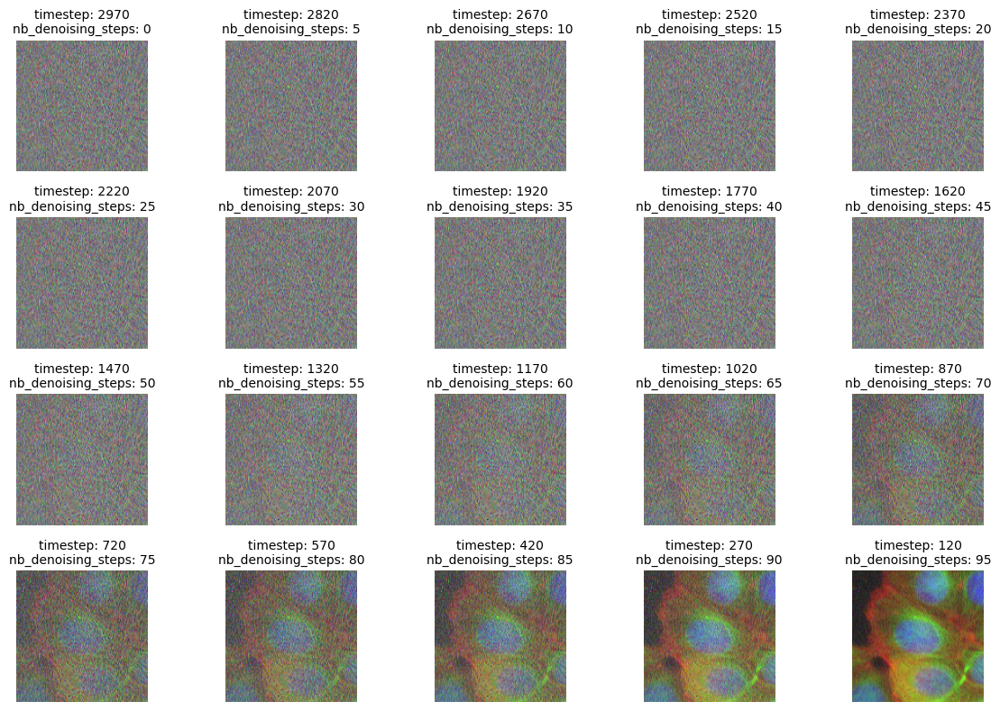

In [163]:
print_grid(denoising_traj_img_list, titles=denoising_traj_times_shown, figsize=(12, 2))

In [141]:
# choose a timestep to start from:
start_timestep = 1000


Fraction of diffusion steps skipped: 0.6666666666666666


Computing starting point using the full trajectory...:   0%|          | 0/2000 [00:00<?, ?it/s]

Starting point for the guided generation:


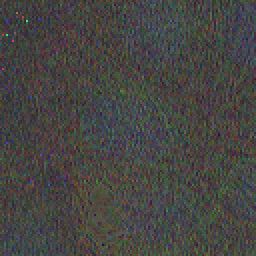

In [142]:
assert start_timestep < DDIM_noise_scheduler.config.num_train_timesteps

frac_diffusion_skipped = (
    DDIM_noise_scheduler.config.num_train_timesteps - start_timestep
) / DDIM_noise_scheduler.config.num_train_timesteps
print("Fraction of diffusion steps skipped:", frac_diffusion_skipped)

# Retreive the starting semi-gaussian
# use the full trajectory
DDIM_noise_scheduler.set_timesteps(DDIM_noise_scheduler.config.num_train_timesteps)

with torch.no_grad():
    starting_gauss = (
        sel_samples[orig_cl]["DDIM_Gaussian"][idx_sample]
        .clone()
        .detach()
        .view((1, 3, args.resolution, args.resolution))
    )

    # denoise the inverted Gaussian for the first `num_denoising_steps` steps
    for idx, t in enumerate(
        tqdm(
            DDIM_noise_scheduler.timesteps,
            desc="Computing starting point using the full trajectory...",
            total=DDIM_noise_scheduler.config.num_train_timesteps - start_timestep,
        )
    ):
        # stop at start_timestep
        if t < start_timestep:
            break

        cond_output = DDIM_denoiser(
            starting_gauss, t, class_labels=orig_class_idx
        ).sample

        starting_gauss = DDIM_noise_scheduler.step(
            cond_output,
            t,
            starting_gauss,
        ).prev_sample

print("Starting point for the guided generation:")
starting_gauss_to_show = starting_gauss - starting_gauss.min()
starting_gauss_to_show /= starting_gauss_to_show.max()
starting_gauss_to_show = starting_gauss_to_show * 2 - 1
display(tensor_to_PIL(starting_gauss_to_show).resize((256, 256), Image.NEAREST))

Generate:

In [143]:
images_to_show_list = []

DDIM_pipeline.set_progress_bar_config(leave=False)

nb_first_full_batches = ceil(nb_generated_samples / args.batch_size) - 1
batches: list[int] = [args.batch_size] * nb_first_full_batches
batches += [nb_generated_samples - args.batch_size * nb_first_full_batches]

with torch.no_grad():
    for i, actual_bs in enumerate(tqdm(batches, desc="Batch")):
        batch_idxes = range(i * args.batch_size, i * args.batch_size + batches[i])
        w_batch = guidance_scale_list[batch_idxes]

        # get *fixed*, *target* class embedding
        batch_target_class = target_class_idx.repeat(actual_bs)

        image = DDIM_pipeline(
            class_labels=batch_target_class,
            w=w_batch,
            batch_size=actual_bs,
            num_inference_steps=num_inference_steps,
            start_image=starting_gauss.repeat(actual_bs, 1, 1, 1),
            frac_diffusion_skipped=frac_diffusion_skipped,
        )[0]

        images_to_show_list += image


Batch:   0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

#### Visualize

In [144]:
save_video = False


In [145]:
px = 1 / plt.rcParams["figure.dpi"]  # pixel in inches
fig, ax = plt.subplots(figsize=(6, 6))

ax.imshow(images_to_show_list[0])  # show an initial one first

# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = [
    [ax.imshow(image, animated=True, interpolation=None)]
    for image in images_to_show_list
]

ax.axis("off")

ani = animation.ArtistAnimation(fig, ims, interval=10, blit=True, repeat=False)

# Save the animation
if save_video:
    save_path = "experiments/DMSO_vs_cytoB_translation_experiments/"
    video_name = f"classifier-free_gen_nb_steps{num_inference_steps}"
    video_path = os.path.join(save_path, video_name)
    video_formats = ["mkv", "mp4"]
    for vid_format in video_formats:
        video_full_path = video_path + "." + vid_format
        if os.path.exists(video_full_path):
            timestamp = datetime.now().strftime("%Y-%m-%d-%H-%M-%S")
            warn(
                f"Video {video_full_path} already exists; writting to {video_path}-{timestamp}.{vid_format}"
            )
            ani.save(f"{video_path}-{timestamp}.{vid_format}", fps=5)
        else:
            ani.save(video_full_path, fps=5)

plt.close()

HTML(ani.to_jshtml())


Note: contrary to "forward noise" start, some smoothness along the guidance factor dimension is observed when starting on the inversion trajectory.

For reference:

Starting point for the guided generation:


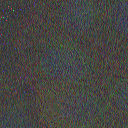

Original image


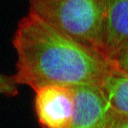

In [146]:
print("Starting point for the guided generation:")
display(tensor_to_PIL(starting_gauss_to_show).resize((128, 128), Image.NEAREST))
print("Original image")
display(sel_samples[orig_cl]["sample_to_show"][idx_sample])

# DDIBs

From: https://arxiv.org/pdf/2203.08382.pdf.

The key observation is that "SGMs [Score-based Generative Models] are implicit optimal transport models, corresponding to SBPs [Schrödinger Bridge Problems] with linear or degenerate drifts".

In particular, DDIMs are SBs, that is: bijective mappings solving an entropy-regularized Optimal Transport problem (the paper is quite concise on the actual H-regularized OT objective being minimized...). So:
$$
    \mathbb{P}_1 \underset{\text{DM 1}}{\longrightarrow} \mathcal{N}(0, 1) \underset{\text{DM 2}}{\longrightarrow} \mathbb{P}_2
$$ 

should provide an *optimal* mapping between two distributions $\mathbb{P}_1$ and $\mathbb{P}_2$ given DM 1 and DM 2 are two diffusion processes (acting here in *reverse* time one vs the other).

The question is *what optimality* exactly is at play here?

In [240]:
num_timesteps = 100


## Transfer to target classes

### Select classes

In [241]:
orig_class = "DMSO"
sample_sel_idx = 1


Selected samples from DMSO class:


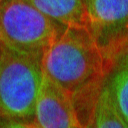

Original class index: 0


In [242]:
print(f"Selected samples from {orig_class} class:")
display(sel_samples[orig_class]["sample_to_show"][sample_sel_idx])

orig_class_idx = torch.tensor(dataset.class_to_idx[orig_class], device=device).long()
print(f"Original class index: {orig_class_idx}")


In [243]:
print(dataset.classes)

['DMSO', 'latrunculin_B_high_conc']


In [244]:
target_classes = [
    "DMSO",
    "latrunculin_B_high_conc",
]

### Generate with Stable Diffusion

In [245]:
SD_noise_scheduler.set_timesteps(num_timesteps)

In [246]:
# ! all target classes should pass through the same batch

orig_latent = sel_samples[orig_class]["SD_Gaussian"][sample_sel_idx].clone().detach()

with torch.no_grad():
    # get target class embedings
    target_class_idx = torch.tensor(
        [dataset.class_to_idx[target_class] for target_class in target_classes],
        device=device,
    )
    target_class_embedding = SD_class_encoder(target_class_idx)
    target_class_embedding = hack_class_embedding(target_class_embedding)
    # repeat the original latent for each target class
    latent = [orig_latent.clone().detach()] * len(target_classes)
    latent = torch.stack(latent)

    for t in tqdm(SD_noise_scheduler.timesteps, desc="Denoising"):
        # 1. predict noise model_output
        model_output = SD_denoiser(
            sample=latent, timestep=t, encoder_hidden_states=target_class_embedding
        ).sample

        # 2. predict previous mean of image x_t-1 and add variance depending on eta
        # eta corresponds to η in paper and should be between [0, 1]
        # do x_t -> x_t-1
        latent = SD_noise_scheduler.step(
            model_output,
            t,
            latent,
        ).prev_sample

Denoising:   0%|          | 0/100 [00:00<?, ?it/s]

Decode the images

In [247]:
# decode the latents
image = SD_autoencoder.decode(
    latent / SD_autoencoder.config.scaling_factor, return_dict=False
)[0]

image = image_processor.postprocess(
    image, output_type="pil", do_denormalize=[True] * image.shape[0]
)

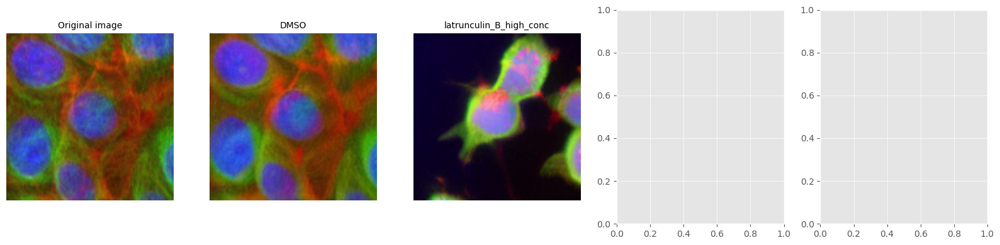

In [248]:
print_grid(
    [sel_samples[orig_class]["sample_to_show"][sample_sel_idx]] + image,
    titles=["Original image"] + target_classes,
)


### Generate with DDIM

In [249]:
DDIM_noise_scheduler.set_timesteps(num_timesteps)

In [250]:
# ! all target classes should pass through the same batch

orig_gauss = sel_samples[orig_class]["DDIM_Gaussian"][sample_sel_idx].clone().detach()

with torch.no_grad():
    # get target class embedings
    target_class_idx = torch.tensor(
        [dataset.class_to_idx[target_class] for target_class in target_classes],
        device=device,
    )

    # repeat the original Gaussian for each target class
    gauss = [orig_gauss.clone().detach()] * len(target_classes)
    gauss = torch.stack(gauss)

    for t in tqdm(DDIM_noise_scheduler.timesteps, desc="Denoising"):
        # 1. predict noise model_output
        model_output = DDIM_denoiser(
            sample=gauss, timestep=t, class_labels=target_class_idx
        ).sample

        # 2. predict previous mean of image x_t-1 and add variance depending on eta
        # eta corresponds to η in paper and should be between [0, 1]
        # do x_t -> x_t-1
        gauss = DDIM_noise_scheduler.step(
            model_output,
            t,
            gauss,
        ).prev_sample

Denoising:   0%|          | 0/100 [00:00<?, ?it/s]

Warning in tensor_to_PIL: tensor.min() = -0.9604799747467041 != -1


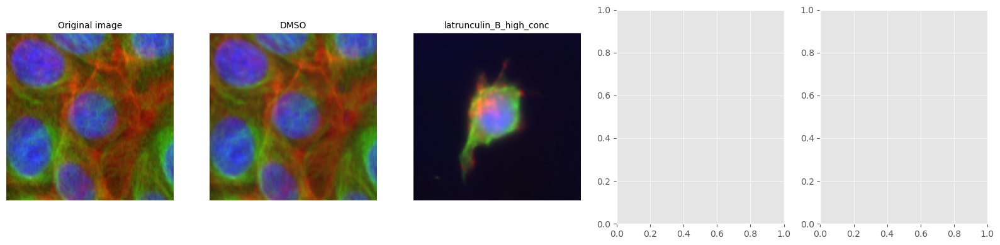

In [251]:
image = tensor_to_PIL(gauss)

print_grid(
    [sel_samples[orig_class]["sample_to_show"][sample_sel_idx]] + image,
    titles=["Original image"] + target_classes,
)


## Cycle consistency

Same method but reversed:

![Capture d’écran du 2023-06-05 17-16-57.png](<attachment:Capture d’écran du 2023-06-05 17-16-57.png>)
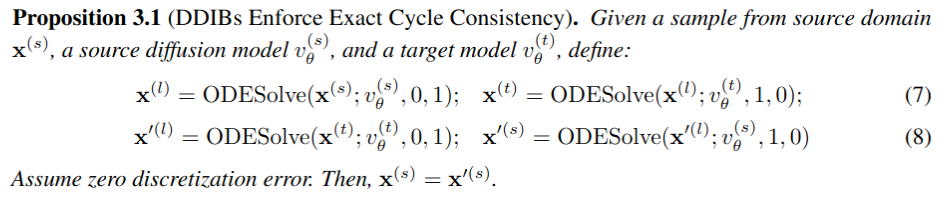

In [252]:
SD_inv_scheduler.set_timesteps(num_timesteps)
DDIM_inv_scheduler.set_timesteps(num_timesteps)


### Stable Diffusion

First invert back to Gaussian space

In [253]:
with torch.no_grad():
    latent = latent.clone().detach()

    for t in tqdm(
        SD_inv_scheduler.timesteps, desc="Inverting *back* to Gaussian space..."
    ):
        model_output = SD_denoiser(
            latent, t, encoder_hidden_states=target_class_embedding
        ).sample

        latent = SD_inv_scheduler.step(
            model_output,
            t,
            latent,
        ).prev_sample

Inverting *back* to Gaussian space...:   0%|          | 0/100 [00:00<?, ?it/s]

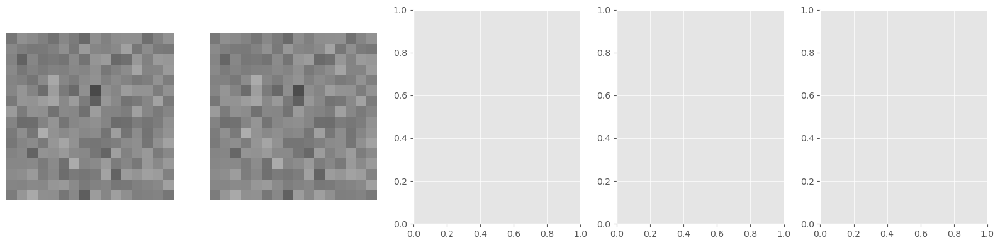

In [254]:
print_grid(tensor_to_PIL(latent))

Then to the original image space

In [255]:
with torch.no_grad():
    inv_image = latent.clone().detach()

    orig_class_embedding = SD_class_encoder(orig_class_idx.repeat(len(target_classes)))
    orig_class_embedding = hack_class_embedding(orig_class_embedding)

    for t in tqdm(SD_noise_scheduler.timesteps, desc="Regenerating source images..."):
        model_output = SD_denoiser(
            inv_image, t, encoder_hidden_states=orig_class_embedding
        ).sample

        inv_image = SD_noise_scheduler.step(
            model_output,
            t,
            inv_image,
        ).prev_sample

Regenerating source images...:   0%|          | 0/100 [00:00<?, ?it/s]

In [256]:
# decode the latents
image = SD_autoencoder.decode(
    inv_image / SD_autoencoder.config.scaling_factor, return_dict=False
)[0]

image = image_processor.postprocess(
    image, output_type="pil", do_denormalize=[True] * image.shape[0]
)

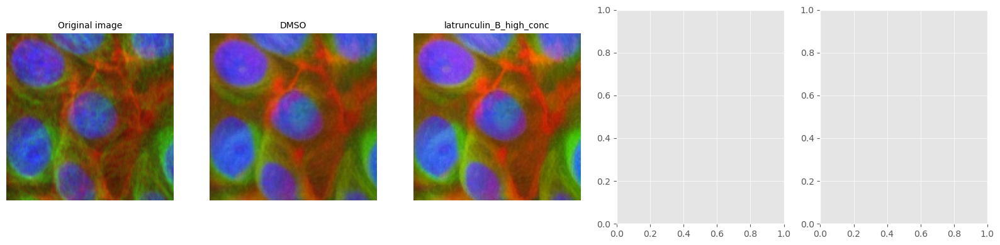

In [257]:
print_grid(
    [sel_samples[orig_class]["sample_to_show"][sample_sel_idx]] + image,
    titles=["Original image"] + target_classes,
)


### DDIM

First invert back to Gaussian space

In [258]:
with torch.no_grad():
    for t in tqdm(
        DDIM_inv_scheduler.timesteps, desc="Inverting *back* to Gaussian space..."
    ):
        model_output = DDIM_denoiser(gauss, t, class_labels=target_class_idx).sample

        gauss = DDIM_inv_scheduler.step(
            model_output,
            t,
            gauss,
        ).prev_sample


Inverting *back* to Gaussian space...:   0%|          | 0/100 [00:00<?, ?it/s]

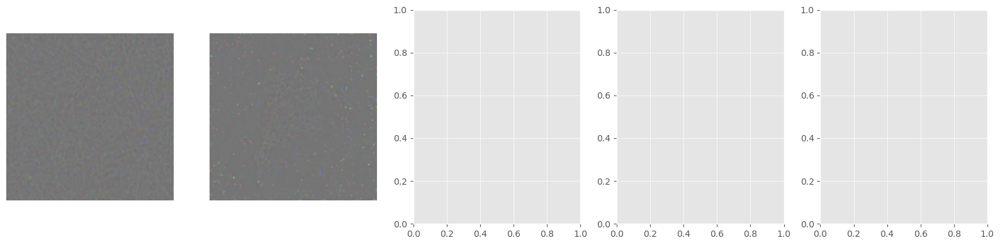

In [259]:
gauss_to_show = gauss - gauss.min()
gauss_to_show /= gauss_to_show.max()
gauss_to_show = gauss_to_show * 2 - 1

print_grid(tensor_to_PIL(gauss_to_show))

Then to the original image space

In [260]:
with torch.no_grad():
    inv_image = gauss.clone().detach()

    for t in tqdm(DDIM_noise_scheduler.timesteps, desc="Regenerating source images..."):
        model_output = DDIM_denoiser(inv_image, t, class_labels=orig_class_idx).sample

        inv_image = DDIM_noise_scheduler.step(
            model_output,
            t,
            inv_image,
        ).prev_sample


Regenerating source images...:   0%|          | 0/100 [00:00<?, ?it/s]

Warning in tensor_to_PIL: tensor.min() = -0.9577097296714783 != -1


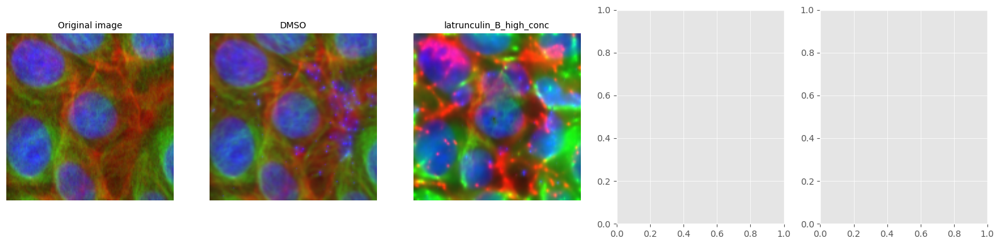

In [261]:
print_grid(
    [sel_samples[orig_class]["sample_to_show"][sample_sel_idx]]
    + tensor_to_PIL(inv_image),
    titles=["Original image"] + target_classes,
)

Mmhhh...